# Raport Walidacyjny 13.06.2025


## Btrak określenia jednego finalnego modelu - porównamy wszystkie

In [2]:
import numpy as np 
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats.mstats import winsorize
from sklearn.preprocessing import StandardScaler, OrdinalEncoder, OneHotEncoder
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.impute import SimpleImputer
from datetime import datetime
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as umap
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import LabelBinarizer
import shap
from itertools import product
import plotly.graph_objects as go
from minisom import MiniSom
from sklearn.preprocessing import LabelEncoder
from sklearn.cluster import OPTICS
from sklearn.metrics import pairwise_distances
from scipy.spatial.distance import cdist
from sklearn.model_selection import train_test_split

# Dane przygotowane do trenowania modeli

In [3]:
data = pd.read_csv('data_after_prep.csv')

In [4]:
data.columns

Index(['emp_length', 'annual_income', 'dti', 'loan_amount', 'total_acc',
       'is_employed', 'date_diff', 'location_Northeast', 'location_South',
       'location_West', 'wealth_low', 'wealth_med', 'law_regulations_moderate',
       'law_regulations_restrictive', 'purpose_grouped_credit card',
       'purpose_grouped_other', 'verification_status_Source Verified',
       'verification_status_Verified', 'loan_status_Current',
       'loan_status_Fully Paid', 'home_ownership_NONE', 'home_ownership_OTHER',
       'home_ownership_OWN', 'home_ownership_RENT', '60_month_term'],
      dtype='object')

In [5]:
data.head()

,emp_length,annual_income,dti,loan_amount,total_acc,is_employed,date_diff,location_Northeast,location_South,location_West,...,purpose_grouped_other,verification_status_Source Verified,verification_status_Verified,loan_status_Current,loan_status_Fully Paid,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,60_month_term
0,-1.396331,-1.227716,-1.849281,-1.249637,-1.638577,0.196775,1.961898,0,1,0,...,1,1,0,0,0,0,0,0,1,1
1,1.129782,-0.375292,-1.196722,-1.176650,-1.638577,0.196775,2.999245,0,0,1,...,1,1,0,0,1,0,0,0,1,0
2,-0.273614,-0.301255,1.132987,0.137112,-1.001180,0.196775,2.952447,0,0,1,...,1,0,0,0,0,0,0,0,1,0
3,-1.396331,-0.617473,-1.189222,-0.957690,-1.183294,0.196775,2.554668,0,1,0,...,1,1,0,0,1,0,0,0,0,1
4,1.410461,0.617947,-1.652763,-1.103663,0.546784,0.196775,2.999245,0,0,0,...,1,0,1,0,1,0,0,0,0,0


In [6]:
means = data.mean(axis=0)
stds = data.std(axis=0)

print("Średnie cech:", means)
print("Odchylenia standardowe cech:", stds)

Średnie cech: emp_length                            -1.267248e-16
annual_income                         -9.695917e-16
dti                                    6.483592e-17
loan_amount                           -8.841262e-17
total_acc                             -2.947087e-17
is_employed                            8.251844e-17
date_diff                              7.367718e-18
location_Northeast                     2.452043e-01
location_South                         3.279500e-01
location_West                          2.868882e-01
wealth_low                             6.789195e-02
wealth_med                             2.203443e-03
law_regulations_moderate               4.194318e-01
law_regulations_restrictive            4.779915e-01
purpose_grouped_credit card            1.295624e-01
purpose_grouped_other                  3.982787e-01
verification_status_Source Verified    2.534477e-01
verification_status_Verified           3.197584e-01
loan_status_Current                    2.846329e-0

In [7]:
# Średnie sprawdzone przed podziałem ❌ 

Średnia bliska 0, odchylenie standardowe bliskie 1 co zapewnia, że dane są wystandaryzowane. (poza zmiennymi binarnymi)

In [8]:
X = data.select_dtypes(include=[float, int])
X_train, X_temp = train_test_split(X, test_size=0.4, random_state=42)
X_val, X_test = train_test_split(X_temp, test_size=0.5, random_state=42)

In [9]:
# podział train val test dobrze zrobiony ✅ 

In [13]:
X_train.describe(include='all')

,emp_length,annual_income,dti,loan_amount,total_acc,is_employed,date_diff,location_Northeast,location_South,location_West,...,purpose_grouped_other,verification_status_Source Verified,verification_status_Verified,loan_status_Current,loan_status_Fully Paid,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,60_month_term
count,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,...,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000,23145.000000
mean,0.002226,0.005981,-0.011446,0.003959,-0.001759,-0.000507,-0.002831,0.241996,0.330050,0.286844,...,0.395852,0.254223,0.322186,0.027652,0.833787,0.000086,0.002290,0.073234,0.479801,0.267228
std,0.998322,0.999373,0.999366,0.999491,1.000463,1.001259,0.991177,0.428301,0.470241,0.452298,...,0.489044,0.435433,0.467324,0.163977,0.372280,0.009296,0.047799,0.260526,0.499603,0.442522
min,-1.396331,-4.793287,-1.999294,-1.541584,-1.729634,-5.081943,-2.304484,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-0.834972,-0.620023,-0.781185,-0.797119,-0.728010,0.196775,-0.838159,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,-0.273614,0.029416,0.000385,-0.154835,-0.181670,0.196775,0.089993,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.129782,0.639668,0.775955,0.575032,0.637841,0.196775,0.557970,0.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,1.410461,8.381791,2.493609,2.177091,2.550032,0.196775,2.952447,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [14]:
X_val.describe(include='all')

,emp_length,annual_income,dti,loan_amount,total_acc,is_employed,date_diff,location_Northeast,location_South,location_West,...,purpose_grouped_other,verification_status_Source Verified,verification_status_Verified,loan_status_Current,loan_status_Fully Paid,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,60_month_term
count,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,...,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000,7715.000000
mean,-0.004395,-0.018000,0.005129,-0.013565,-0.006295,-0.011226,-0.000543,0.243552,0.327155,0.291121,...,0.407907,0.255995,0.313675,0.030849,0.833441,0.000130,0.002333,0.076863,0.478419,0.264161
std,1.001851,0.998424,0.994397,0.997974,0.995482,1.027060,1.000923,0.429253,0.469205,0.454309,...,0.491477,0.436447,0.464016,0.172920,0.372606,0.011385,0.048249,0.266392,0.499566,0.440914
min,-1.396331,-4.881756,-1.999294,-1.505091,-1.820691,-5.081943,-2.304484,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,-0.834972,-0.661178,-0.751182,-0.826314,-0.773538,0.196775,-0.853758,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,-0.273614,-0.004143,0.025887,-0.154835,-0.181670,0.196775,0.089993,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1.129782,0.576170,0.782705,0.575032,0.637841,0.196775,0.557970,0.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,1.000000,1.000000
max,1.410461,7.600479,2.490608,2.177091,2.550032,0.196775,2.999245,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


# Wizualizacje

## PCA

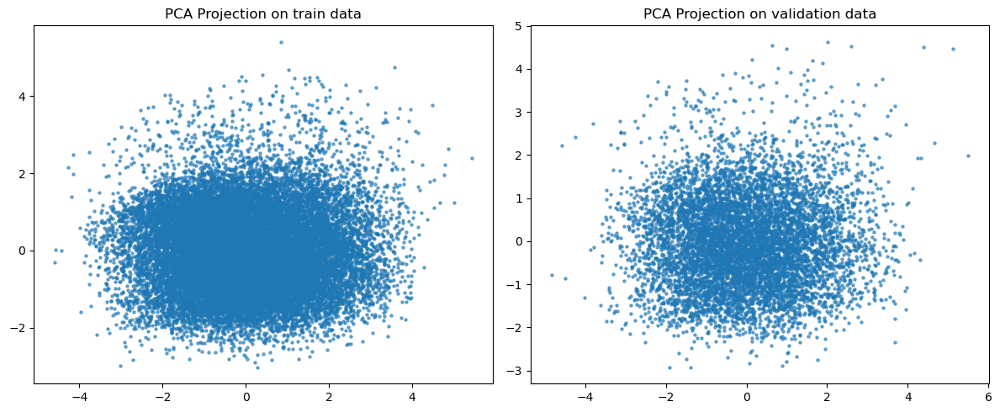

In [7]:
pca = PCA(n_components=2)
X_pca_train = pca.fit_transform(X_train)
X_pca_val = pca.transform(X_val)

fig, axes = plt.subplots(1, 2, figsize=(12, 5))
    
sc1 = axes[0].scatter(X_pca_train[:,0], X_pca_train[:,1], s=5, alpha=0.6)
axes[0].set_title('PCA Projection on train data')
sc2 = axes[1].scatter(X_pca_val[:,0], X_pca_val[:,1], s=5, alpha=0.6)
axes[1].set_title('PCA Projection on validation data')
plt.tight_layout()
plt.show()


## TSNE

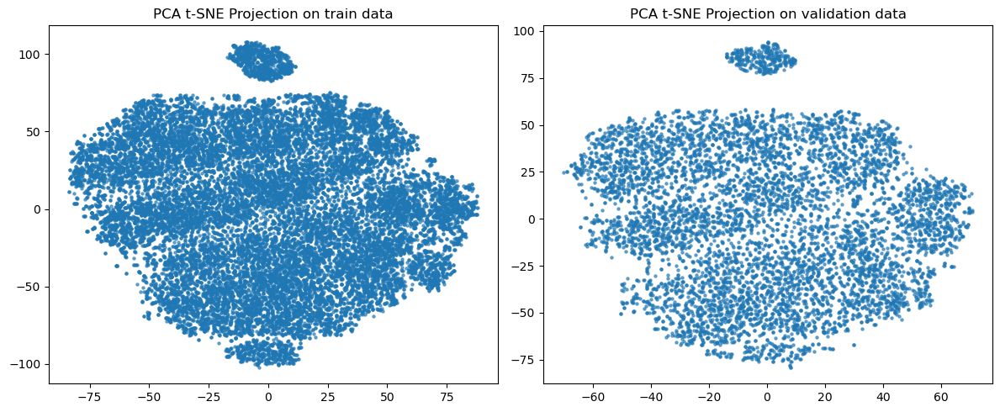

In [8]:
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
X_tsne_train = tsne.fit_transform(X_train)
X_tsne_val = tsne.fit_transform(X_val)

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sc1 = axes[0].scatter(X_tsne_train[:,0], X_tsne_train[:,1], s=5, alpha=0.6)
axes[0].set_title('PCA t-SNE Projection on train data')
sc2 = axes[1].scatter(X_tsne_val[:,0], X_tsne_val[:,1], s=5, alpha=0.6)
axes[1].set_title('PCA t-SNE Projection on validation data')
plt.tight_layout()
plt.show()


In [ ]:
# rozkład zachowany na zbiorze walidacyjnym ✅ 

## UMAP

C:\ProgramData\anaconda3\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


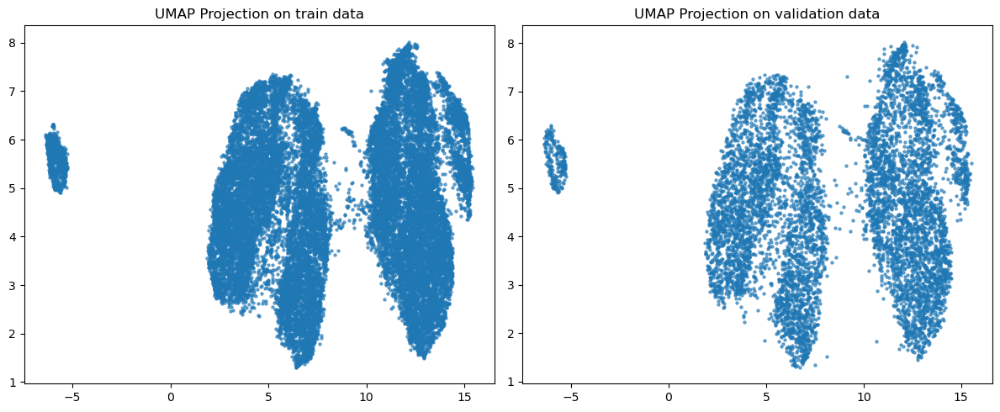

In [9]:
umap_model = umap.UMAP(n_neighbors=15, min_dist=0.1, random_state=42)
X_umap_train = umap_model.fit_transform(X_train)
X_umap_val  = umap_model.transform(X_val)
fig, axes = plt.subplots(1, 2, figsize=(12, 5))
sc1 = axes[0].scatter(X_umap_train[:,0], X_umap_train[:,1], s=5, alpha=0.6)
axes[0].set_title('UMAP Projection on train data')
sc2 = axes[1].scatter(X_umap_val[:,0], X_umap_val[:,1], s=5, alpha=0.6)
axes[1].set_title('UMAP Projection on validation data')
plt.tight_layout()
plt.show()

In [ ]:
# Rozkład zachowany ✅ 

# Redukowanie ilości zmiennych

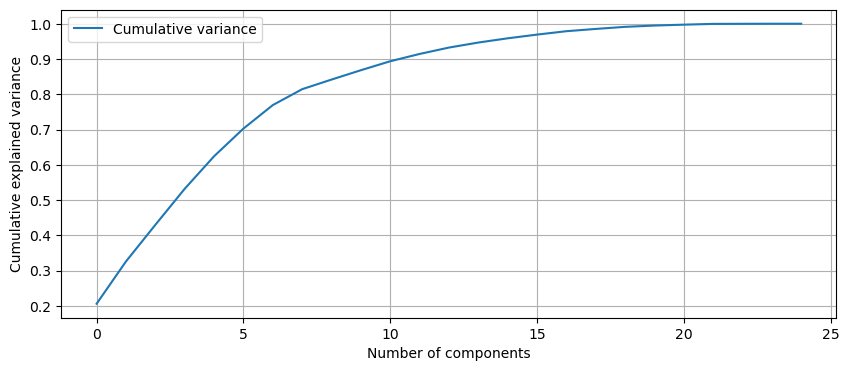

In [10]:
pca = PCA(n_components=X_train.shape[1], random_state=42)
pca.fit(X_train)

cum_var = np.cumsum(pca.explained_variance_ratio_)

plt.figure(figsize=(10, 4))
plt.plot(cum_var, label='Cumulative variance')
plt.xlabel('Number of components')
plt.ylabel('Cumulative explained variance')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
# Wykres powinien byc przed wykonaniem pca ❌ 

In [11]:
X_pca_train = X_train
X_pca_val = X_val

# Parametry modeli

In [12]:
def model_eval(X, labels):
    unique_labels = set(labels)
    if len(unique_labels) < 2 or (len(unique_labels) == 1 and -1 in unique_labels):
        return {'silhouette': None, 'calinski': None, 'davies': None}
    
    silhouette = silhouette_score(X, labels)
    calinski = calinski_harabasz_score(X, labels)
    davies = davies_bouldin_score(X, labels)
    
    print(f'silhouette: {silhouette:.3f}, calinski: {calinski:.3f}, davies: {davies:.3f}')
    
    return {'silhouette': silhouette, 'calinski': calinski, 'davies': davies}

## Optymalna ilość klastrów

In [14]:
def find_optimal_clusters_multi_algorithm(X, algorithms=None, max_k=20):
    """
    Evaluate multiple clustering algorithms across different k values
    """
    
    if algorithms is None:
        algorithms = {
            'KMeans': KMeans,
            'AgglomerativeClustering': AgglomerativeClustering,
            'GaussianMixture': GaussianMixture
        }
    
    results = {}
    k_range = range(2, max_k + 1)
    
    print("Multi-Algorithm Cluster Evaluation:")
    print("=" * 60)
    
    for algo_name, algo_class in algorithms.items():
        print(f"\n{algo_name} Results:")
        print("-" * 40)
        
        silhouette_scores = []
        calinski_scores = []
        davies_scores = []
        inertias = []
        
        for k in k_range:
            print(f"\nK = {k}:")
            
            try:
                # Handle different algorithm parameter names
                if algo_name == 'GaussianMixture':
                    model = algo_class(n_components=k, random_state=42)
                    model.fit(X)
                    labels = model.predict(X)
                    inertia = None  # GMM doesn't have inertia
                elif algo_name == 'AgglomerativeClustering':
                    model = algo_class(n_clusters=k)
                    labels = model.fit_predict(X)
                    inertia = getattr(model, 'inertia_', None)
                else:
                    model = algo_class(n_clusters=k, random_state=42)
                    labels = model.fit_predict(X)
                    inertia = getattr(model, 'inertia_', None)
                
                # Evaluate clustering
                metrics = model_eval(X, labels)
                
                silhouette_scores.append(metrics['silhouette'])
                calinski_scores.append(metrics['calinski'])
                davies_scores.append(metrics['davies'])
                inertias.append(inertia)
                
            except Exception as e:
                print(f"Error with {algo_name} at k={k}: {e}")
                silhouette_scores.append(None)
                calinski_scores.append(None)
                davies_scores.append(None)
                inertias.append(None)
        
        # Store results
        results[algo_name] = {
            'silhouette_scores': silhouette_scores,
            'calinski_scores': calinski_scores,
            'davies_scores': davies_scores,
            'inertias': inertias
        }
    
    # Plot comparison
    plot_algorithm_comparison(results, k_range)
    
    # Find best k for each algorithm and metric
    print_best_k_summary(results, k_range)
    
    return results

def plot_algorithm_comparison(results, k_range):
    """Plot comparison of different algorithms across metrics"""
    
    algorithms = list(results.keys())
    n_algorithms = len(algorithms)
    
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    axes = axes.flatten()
    
    metrics = ['silhouette_scores', 'calinski_scores', 'davies_scores', 'inertias']
    titles = ['Silhouette Score (Higher is Better)', 
              'Calinski-Harabasz Score (Higher is Better)',
              'Davies-Bouldin Score (Lower is Better)', 
              'Inertia/WCSS (Lower is Better)']
    
    colors = ['blue', 'red', 'green', 'orange', 'purple', 'brown']
    
    for i, (metric, title) in enumerate(zip(metrics, titles)):
        ax = axes[i]
        
        for j, algo in enumerate(algorithms):
            scores = results[algo][metric]
            # Filter out None values
            valid_k = [k for k, score in zip(k_range, scores) if score is not None]
            valid_scores = [score for score in scores if score is not None]
            
            if valid_scores:  # Only plot if we have valid scores
                ax.plot(valid_k, valid_scores, marker='o', 
                       label=algo, color=colors[j % len(colors)])
        
        ax.set_title(title)
        ax.set_xlabel('Number of clusters (k)')
        ax.set_ylabel(title.split('(')[0].strip())
        ax.legend()
        ax.grid(True)
    
    plt.tight_layout()
    plt.show()

def print_best_k_summary(results, k_range):
    """Print summary of best k for each algorithm and metric"""
    
    print(f"\n{'='*60}")
    print("BEST K SUMMARY")
    print(f"{'='*60}")
    
    for algo in results.keys():
        print(f"\n{algo}:")
        
        # Silhouette (higher is better)
        sil_scores = results[algo]['silhouette_scores']
        valid_sil = [(k, score) for k, score in zip(k_range, sil_scores) if score is not None]
        if valid_sil:
            best_k_sil = max(valid_sil, key=lambda x: x[1])
            print(f"  Best k (Silhouette): {best_k_sil[0]} (score: {best_k_sil[1]:.3f})")
        
        # Calinski-Harabasz (higher is better)
        cal_scores = results[algo]['calinski_scores']
        valid_cal = [(k, score) for k, score in zip(k_range, cal_scores) if score is not None]
        if valid_cal:
            best_k_cal = max(valid_cal, key=lambda x: x[1])
            print(f"  Best k (Calinski-Harabasz): {best_k_cal[0]} (score: {best_k_cal[1]:.3f})")
        
        # Davies-Bouldin (lower is better)
        dav_scores = results[algo]['davies_scores']
        valid_dav = [(k, score) for k, score in zip(k_range, dav_scores) if score is not None]
        if valid_dav:
            best_k_dav = min(valid_dav, key=lambda x: x[1])
            print(f"  Best k (Davies-Bouldin): {best_k_dav[0]} (score: {best_k_dav[1]:.3f})")


Multi-Algorithm Cluster Evaluation:

GaussianMixture Results:
----------------------------------------

K = 2:
silhouette: 0.376, calinski: 2412.013, davies: 1.298

K = 3:
silhouette: 0.048, calinski: 782.992, davies: 4.299

K = 4:
silhouette: 0.009, calinski: 999.113, davies: 2.842

K = 5:
silhouette: 0.022, calinski: 866.709, davies: 4.721

K = 6:
silhouette: 0.012, calinski: 998.794, davies: 4.422

K = 7:
silhouette: -0.002, calinski: 607.602, davies: 4.881

K = 8:
silhouette: -0.003, calinski: 796.712, davies: 3.752

K = 9:
silhouette: -0.006, calinski: 616.454, davies: 3.978

K = 10:
silhouette: -0.012, calinski: 438.704, davies: 4.391

K = 11:
silhouette: -0.009, calinski: 426.226, davies: 4.387

K = 12:
silhouette: -0.019, calinski: 372.127, davies: 5.333

K = 13:
silhouette: 0.011, calinski: 491.771, davies: 4.234

K = 14:
silhouette: 0.002, calinski: 419.708, davies: 4.427

K = 15:
silhouette: -0.005, calinski: 401.721, davies: 4.648

K = 16:
silhouette: -0.013, calinski: 375.

C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.131, calinski: 3631.984, davies: 2.431

K = 3:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.147, calinski: 3545.632, davies: 1.908

K = 4:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.108, calinski: 3071.572, davies: 2.134

K = 5:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.105, calinski: 2790.273, davies: 2.171

K = 6:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.101, calinski: 2522.274, davies: 2.158

K = 7:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.097, calinski: 2314.119, davies: 2.075

K = 8:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.097, calinski: 2161.941, davies: 2.048

K = 9:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.095, calinski: 2006.807, davies: 2.152

K = 10:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.092, calinski: 1880.393, davies: 2.185

K = 11:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.090, calinski: 1766.735, davies: 2.185

K = 12:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.087, calinski: 1673.578, davies: 2.164

K = 13:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.090, calinski: 1594.700, davies: 2.166

K = 14:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.086, calinski: 1523.010, davies: 2.169

K = 15:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.087, calinski: 1458.176, davies: 2.162

K = 16:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.086, calinski: 1400.196, davies: 2.152

K = 17:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.083, calinski: 1348.485, davies: 2.161

K = 18:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.080, calinski: 1303.005, davies: 2.208

K = 19:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.081, calinski: 1259.115, davies: 2.168

K = 20:


C:\ProgramData\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


silhouette: 0.079, calinski: 1216.956, davies: 2.215

AgglomerativeClustering Results:
----------------------------------------

K = 2:
silhouette: 0.403, calinski: 2719.081, davies: 1.113

K = 3:
silhouette: 0.099, calinski: 2722.794, davies: 2.315

K = 4:
silhouette: 0.086, calinski: 2431.102, davies: 2.490

K = 5:
silhouette: 0.061, calinski: 2108.171, davies: 2.615

K = 6:
silhouette: 0.058, calinski: 1903.489, davies: 2.608

K = 7:
silhouette: 0.046, calinski: 1710.110, davies: 2.574

K = 8:
silhouette: 0.044, calinski: 1569.076, davies: 2.692

K = 9:
silhouette: 0.043, calinski: 1450.997, davies: 2.622

K = 10:
silhouette: 0.039, calinski: 1354.474, davies: 2.605

K = 11:
silhouette: 0.037, calinski: 1273.298, davies: 2.599

K = 12:
silhouette: 0.036, calinski: 1201.337, davies: 2.688

K = 13:
silhouette: 0.034, calinski: 1142.116, davies: 2.739

K = 14:
silhouette: 0.034, calinski: 1087.991, davies: 2.731

K = 15:
silhouette: 0.035, calinski: 1042.026, davies: 2.752

K = 16:
sil

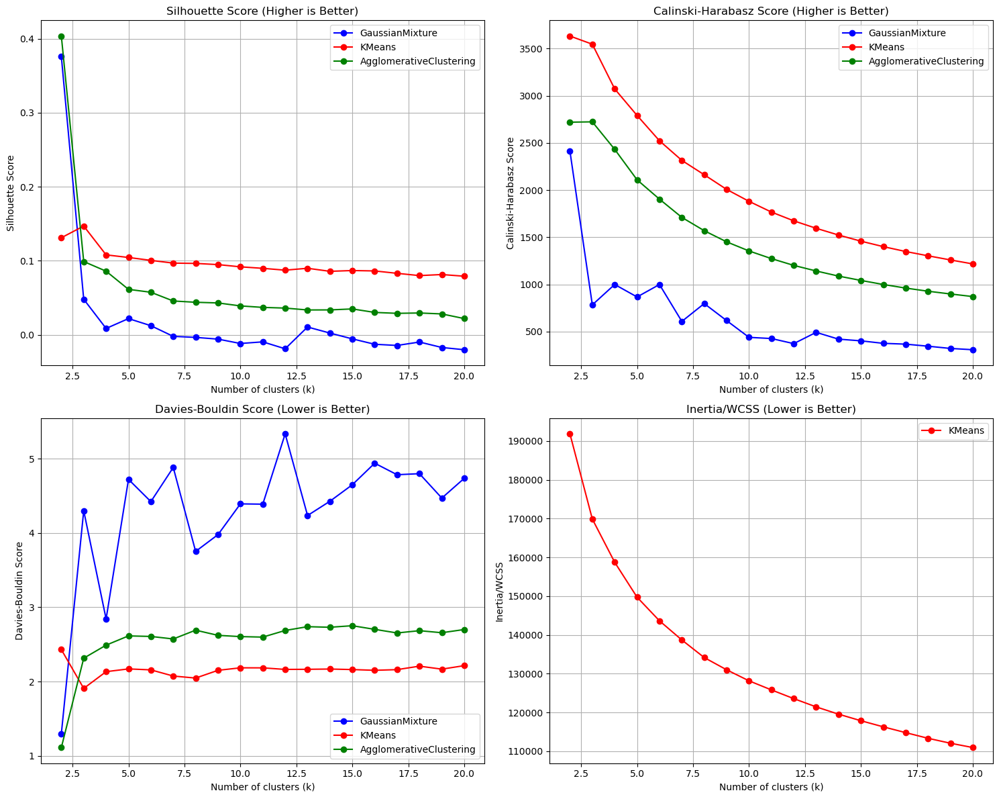


BEST K SUMMARY

GaussianMixture:
  Best k (Silhouette): 2 (score: 0.376)
  Best k (Calinski-Harabasz): 2 (score: 2412.013)
  Best k (Davies-Bouldin): 2 (score: 1.298)

KMeans:
  Best k (Silhouette): 3 (score: 0.147)
  Best k (Calinski-Harabasz): 2 (score: 3631.984)
  Best k (Davies-Bouldin): 3 (score: 1.908)

AgglomerativeClustering:
  Best k (Silhouette): 2 (score: 0.403)
  Best k (Calinski-Harabasz): 3 (score: 2722.794)
  Best k (Davies-Bouldin): 2 (score: 1.113)


In [15]:
algorithms = {  
        'GaussianMixture': GaussianMixture,
        'KMeans': KMeans,
        'AgglomerativeClustering': AgglomerativeClustering,
        }

results = find_optimal_clusters_multi_algorithm(X_pca_train, max_k=20, algorithms=algorithms)

# Modele i wizualizacje klasteryzacji

In [16]:
def plot_tsne_umap_clusters(
    X_tsne_train, X_umap_train, X_tsne_val, X_umap_val,
    labels_train, labels_val,
    title_tsne='t-SNE', title_umap='UMAP'
):
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    
    # t-SNE - Train
    sc1 = axes[0, 0].scatter(X_tsne_train[:, 0], X_tsne_train[:, 1], c=labels_train, s=5, alpha=0.6, cmap='Spectral')
    axes[0, 0].set_title(f'{title_tsne} - Train')
    plt.colorbar(sc1, ax=axes[0, 0], label='Cluster Label')
    
    # UMAP - Train
    sc2 = axes[0, 1].scatter(X_umap_train[:, 0], X_umap_train[:, 1], c=labels_train, s=5, alpha=0.6, cmap='Spectral')
    axes[0, 1].set_title(f'{title_umap} - Train')
    plt.colorbar(sc2, ax=axes[0, 1], label='Cluster Label')
    
    # t-SNE - Walidacja
    sc3 = axes[1, 0].scatter(X_tsne_val[:, 0], X_tsne_val[:, 1], c=labels_val, s=5, alpha=0.6, cmap='Spectral')
    axes[1, 0].set_title(f'{title_tsne} - Validation')
    plt.colorbar(sc3, ax=axes[1, 0], label='Cluster Label')
    
    # UMAP - Walidacja
    sc4 = axes[1, 1].scatter(X_umap_val[:, 0], X_umap_val[:, 1], c=labels_val, s=5, alpha=0.6, cmap='Spectral')
    axes[1, 1].set_title(f'{title_umap} - Validation')
    plt.colorbar(sc4, ax=axes[1, 1], label='Cluster Label')
    
    plt.tight_layout()
    plt.show()

In [17]:
labels_dict = {}
labels_dict_val ={}

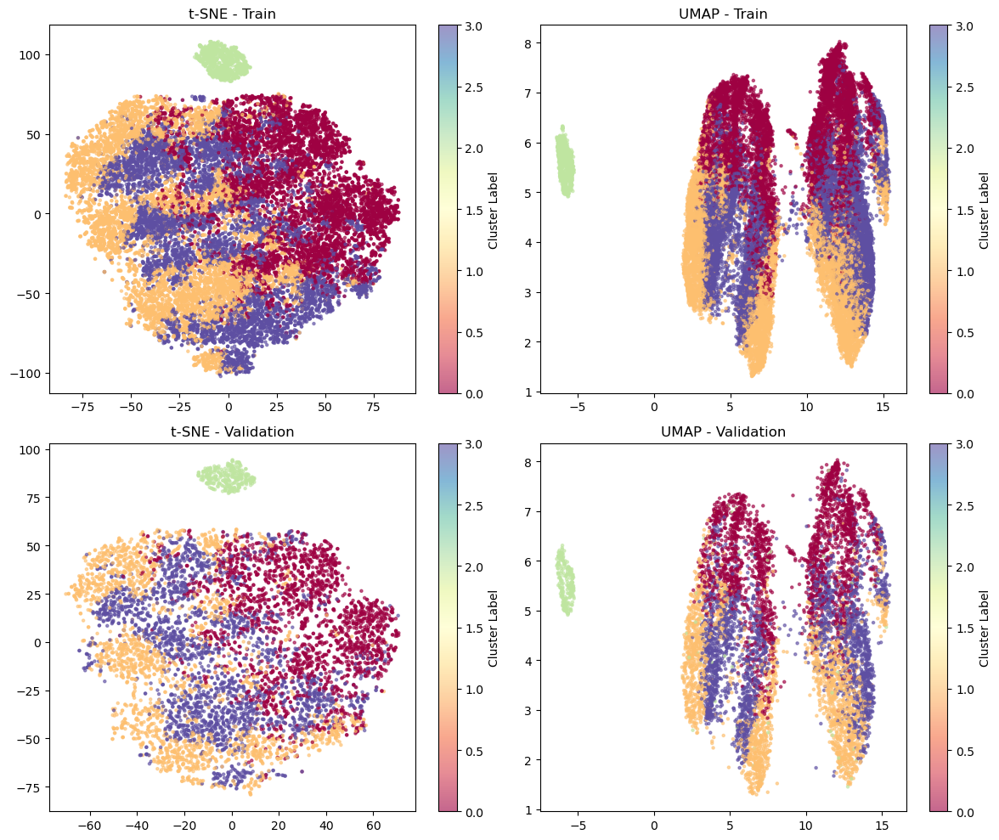

In [18]:
kmeans1 = KMeans(n_clusters=4, init = 'k-means++', n_init=10, algorithm= 'elkan', random_state=42).fit(X_pca_train)
labels_kmeans1 = kmeans1.labels_
labels_dict['kmeans1'] = labels_kmeans1
labels_val_kmeans1 = kmeans1.predict(X_pca_val)
labels_dict_val['kmeans1'] = labels_val_kmeans1
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_kmeans1, labels_val_kmeans1 )

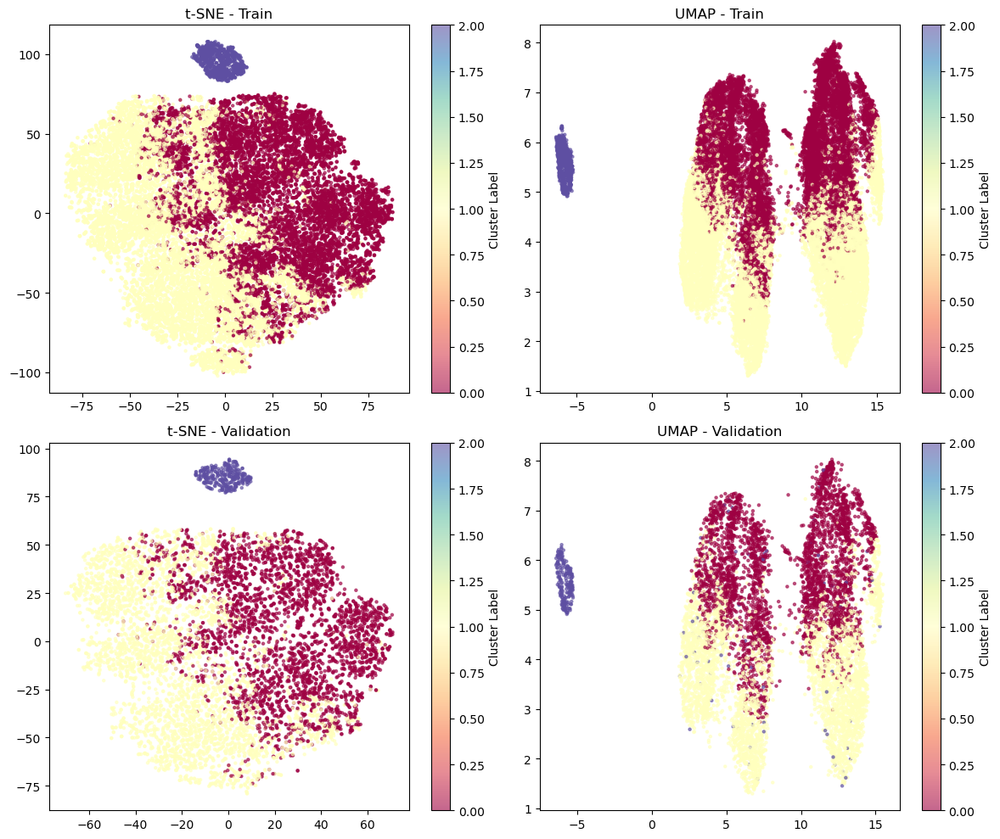

In [19]:
kmeans2 = KMeans(n_clusters=3, init = 'k-means++', n_init=10, algorithm= 'lloyd', random_state=42).fit(X_pca_train)
labels_kmeans2 = kmeans2.labels_
labels_dict['kmeans2'] = labels_kmeans2
labels_val_kmeans2 = kmeans2.predict(X_pca_val)
labels_dict_val['kmeans2'] = labels_val_kmeans2
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_kmeans2, labels_val_kmeans2 )

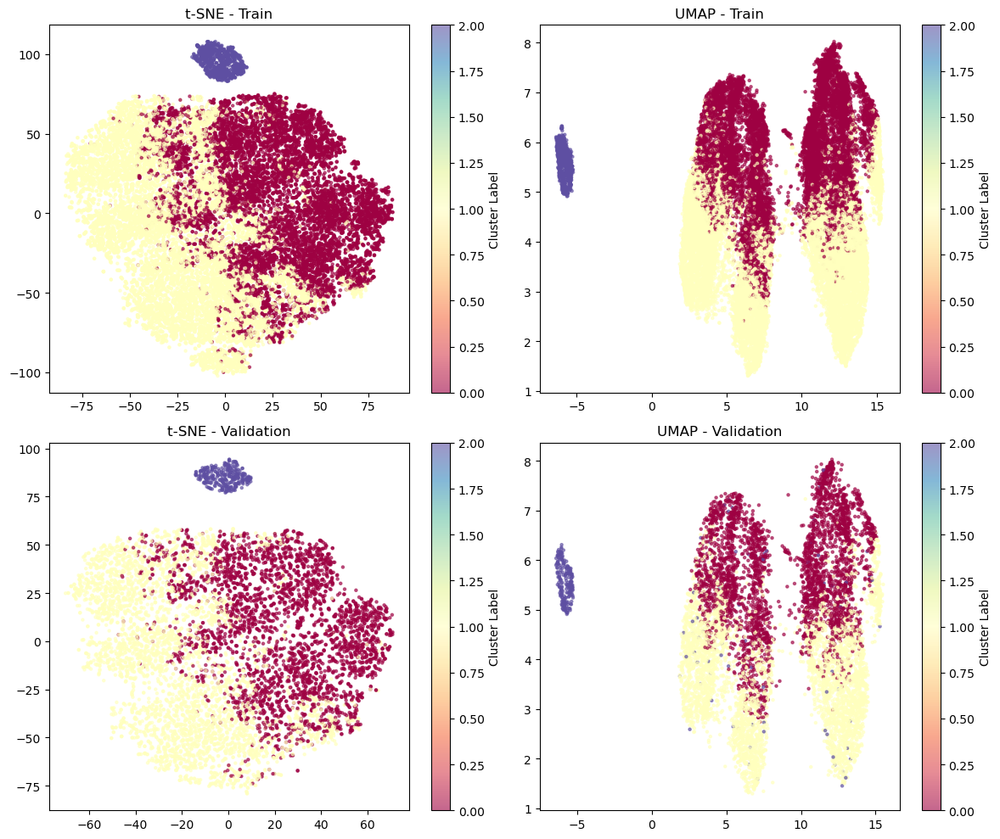

In [20]:
kmeans3 = KMeans(n_clusters=3, init = 'k-means++', n_init=20, algorithm= 'elkan', random_state=42).fit(X_pca_train)
labels_kmeans3 = kmeans3.labels_
labels_dict['kmeans3'] = labels_kmeans3
labels_val_kmeans3 = kmeans3.predict(X_pca_val)
labels_dict_val['kmeans3'] = labels_val_kmeans3
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_kmeans3, labels_val_kmeans3 )

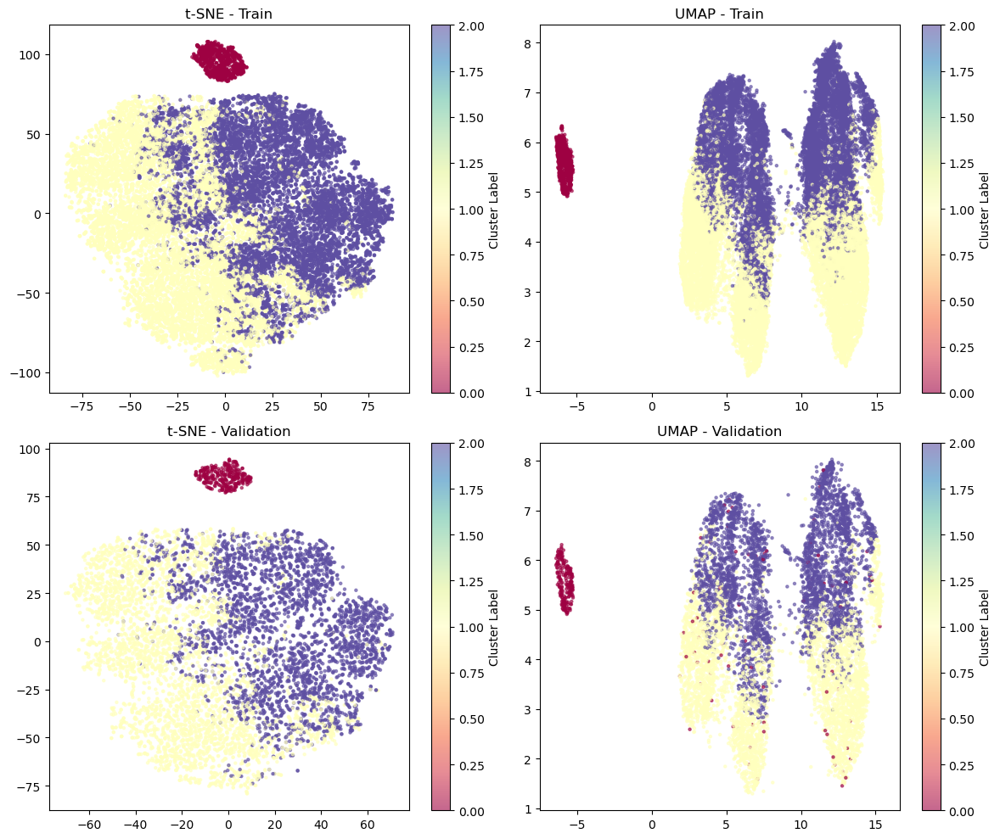

In [21]:
kmeans4 = KMeans(n_clusters=3, init = 'random', n_init=20, algorithm= 'lloyd', random_state=42).fit(X_pca_train)
labels_kmeans4 = kmeans4.labels_
labels_dict['kmeans4'] = labels_kmeans4
labels_val_kmeans4 = kmeans4.predict(X_pca_val)
labels_dict_val['kmeans4'] = labels_val_kmeans4
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_kmeans4, labels_val_kmeans4 )

In [22]:
from sklearn.neighbors import KNeighborsClassifier
knn_model = KNeighborsClassifier(n_neighbors=3)

In [24]:
X_pca_val

,emp_length,annual_income,dti,loan_amount,total_acc,is_employed,date_diff,location_Northeast,location_South,location_West,...,purpose_grouped_other,verification_status_Source Verified,verification_status_Verified,loan_status_Current,loan_status_Fully Paid,home_ownership_NONE,home_ownership_OTHER,home_ownership_OWN,home_ownership_RENT,60_month_term
15727,0.007065,-2.056486,1.592028,-1.140157,-1.638577,0.196775,0.316182,0,0,0,...,0,1,0,0,1,0,0,0,1,0
18336,-0.273614,-0.128526,-0.002615,-0.738730,-1.183294,0.196775,-0.136195,1,0,0,...,0,0,1,0,1,0,0,0,1,0
25376,0.287744,0.618034,-1.945289,0.575032,0.546784,0.196775,-1.352933,0,1,0,...,1,0,0,0,1,0,0,0,0,0
28048,1.410461,0.606988,-1.993294,-0.154835,-0.363783,0.196775,1.735709,0,1,0,...,1,1,0,0,1,0,0,1,0,0
26059,1.410461,-0.161673,0.207404,-0.884703,-0.454840,0.196775,-0.635370,0,1,0,...,1,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24445,1.410461,0.256421,0.886965,2.034767,-0.090613,0.196775,-1.103346,0,0,1,...,0,0,1,1,0,0,0,0,0,1
29255,1.410461,0.224129,0.495429,-0.213225,1.275238,0.196775,-0.377983,0,1,0,...,1,1,0,0,1,0,0,0,0,0
12553,-1.396331,-0.617473,0.469927,-0.519769,0.546784,-5.081943,0.542370,0,1,0,...,0,0,0,0,1,0,0,0,1,0
15353,-0.554293,0.088886,-0.022117,-0.154835,-1.001180,0.196775,1.509521,1,0,0,...,0,1,0,0,1,0,0,0,1,0


In [29]:
X_pca_train = np.asarray(X_pca_train, dtype=np.float64, order='C')
X_pca_val = np.asarray(X_pca_val, dtype=np.float64, order='C')

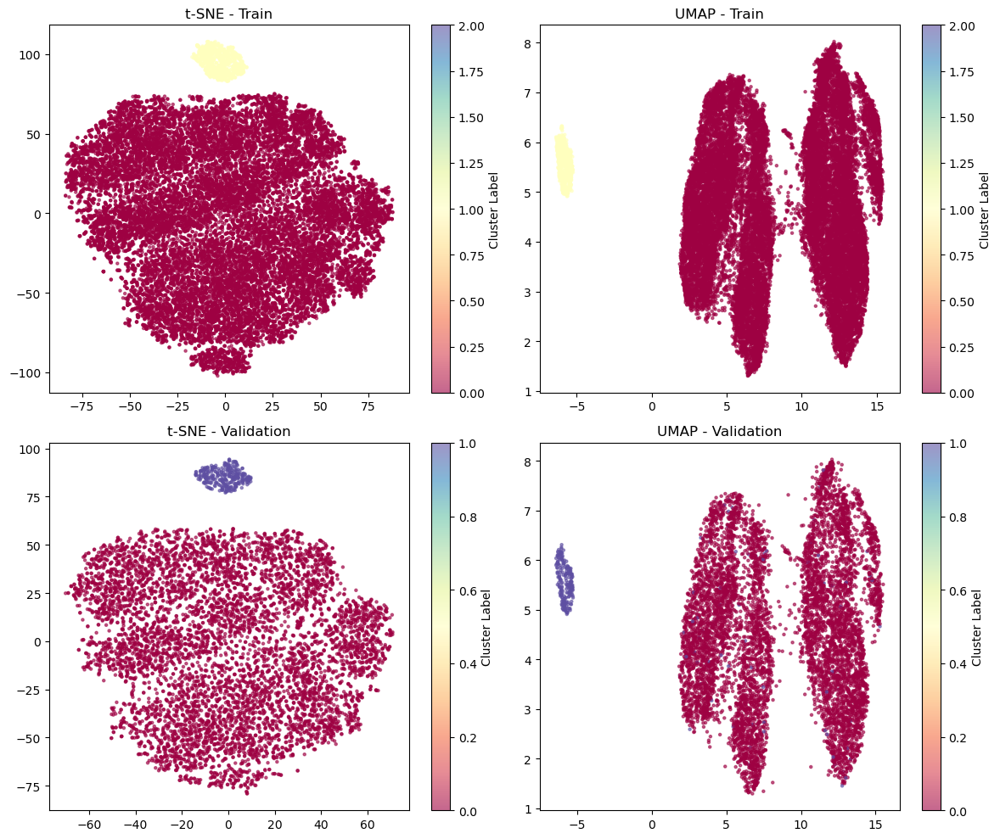

In [30]:
agglomerative1 = AgglomerativeClustering(n_clusters=3, linkage='single').fit(X_pca_train)
labels_agglomerative1 = agglomerative1.labels_
knn_model.fit(X_pca_train, labels_agglomerative1)
labels_val_agglomerative1 = knn_model.predict(X_pca_val)
labels_dict['agglomerative1'] = labels_agglomerative1
labels_dict_val['agglomerative1'] = labels_val_agglomerative1
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_agglomerative1, labels_val_agglomerative1)

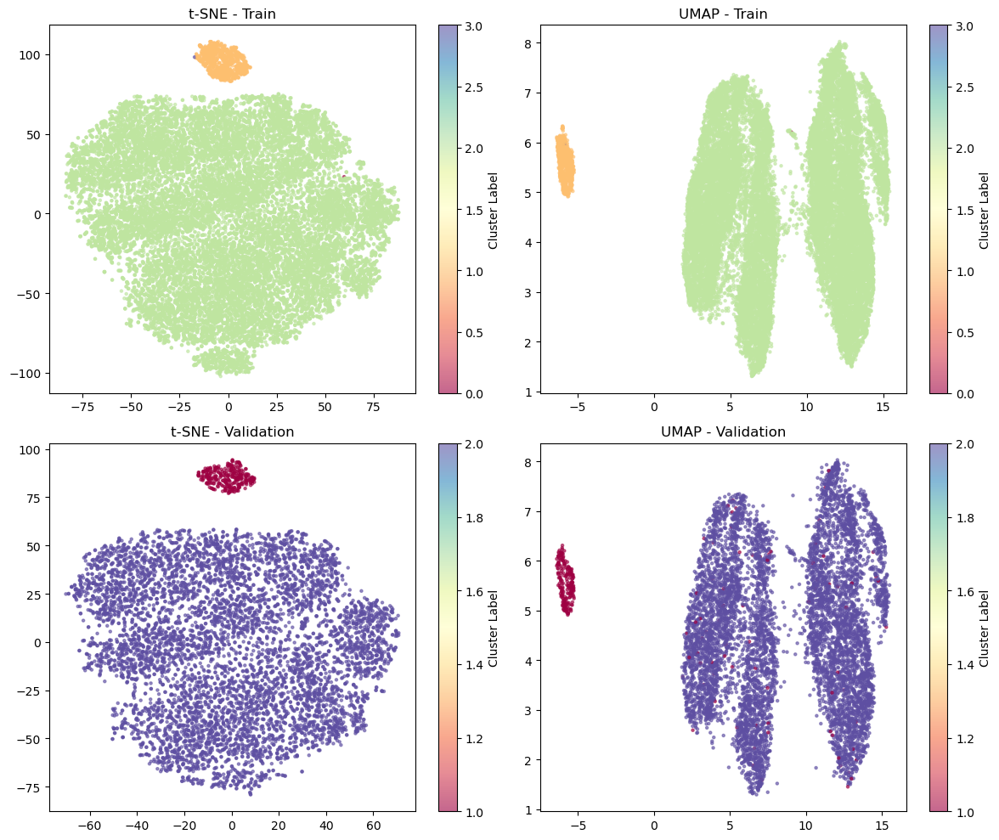

In [31]:
agglomerative2 = AgglomerativeClustering(n_clusters=4, linkage='average').fit(X_pca_train)
labels_agglomerative2 = agglomerative2.labels_
knn_model.fit(X_pca_train, labels_agglomerative2)
labels_val_agglomerative2 = knn_model.predict(X_pca_val)
labels_dict['agglomerative2'] = labels_agglomerative2
labels_dict_val['agglomerative2'] = labels_val_agglomerative2
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_agglomerative2, labels_val_agglomerative2)

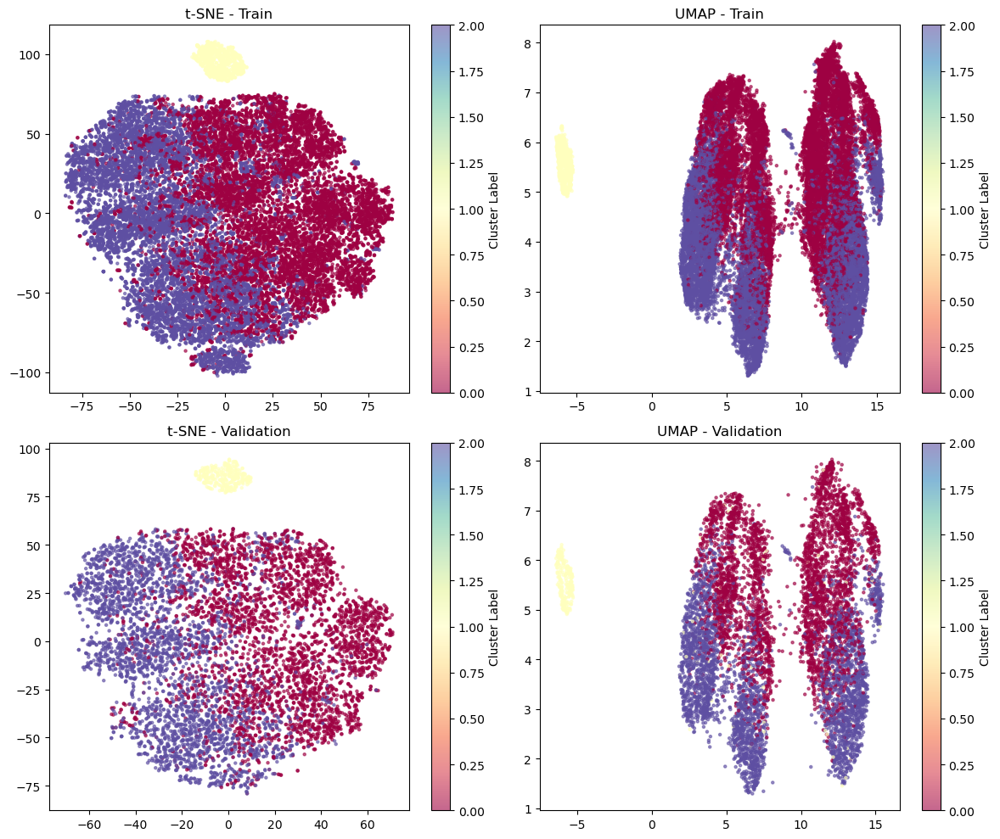

In [32]:
agglomerative3 = AgglomerativeClustering(n_clusters=3, linkage='ward').fit(X_pca_train)
labels_agglomerative3 = agglomerative3.labels_
knn_model.fit(X_pca_train, labels_agglomerative3)
labels_val_agglomerative3 = knn_model.predict(X_pca_val)
labels_dict['agglomerative3'] = labels_agglomerative3
labels_dict_val['agglomerative3'] = labels_val_agglomerative3
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_agglomerative3, labels_val_agglomerative3)

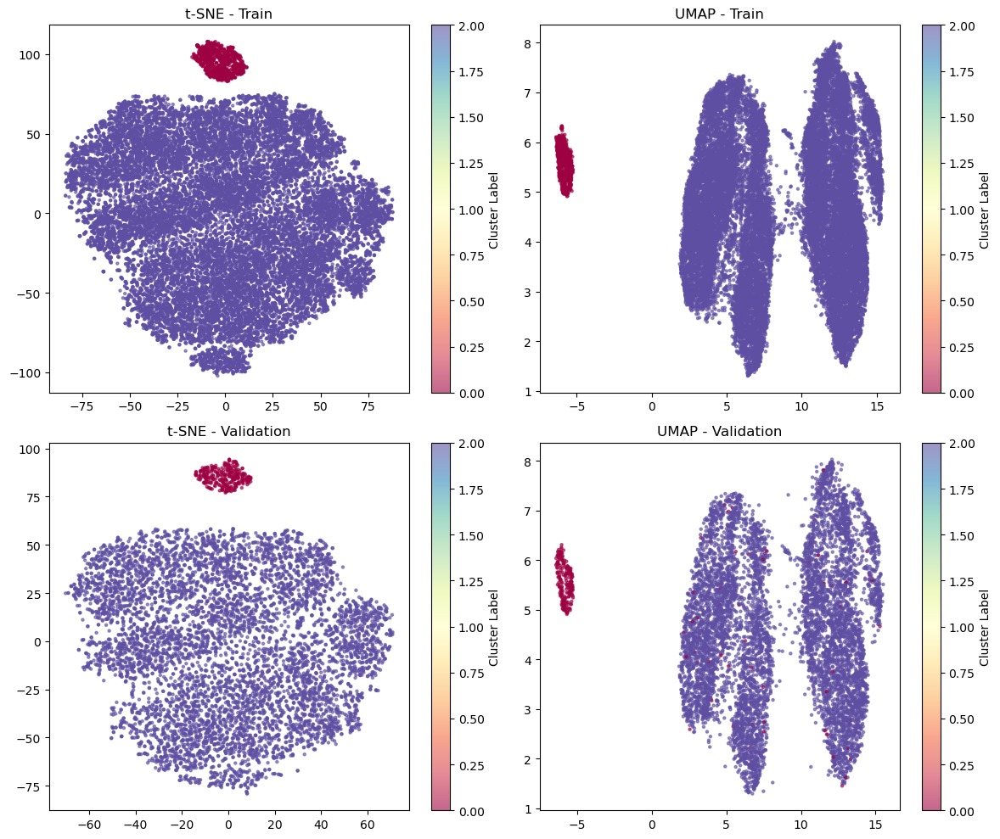

In [33]:
agglomerative4 = AgglomerativeClustering(n_clusters=3, linkage='average').fit(X_pca_train)
labels_agglomerative4 = agglomerative4.labels_
knn_model.fit(X_pca_train, labels_agglomerative4)
labels_val_agglomerative4 = knn_model.predict(X_pca_val)
labels_dict['agglomerative4'] = labels_agglomerative4
labels_dict_val['agglomerative4'] = labels_val_agglomerative4
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_agglomerative4, labels_val_agglomerative4)

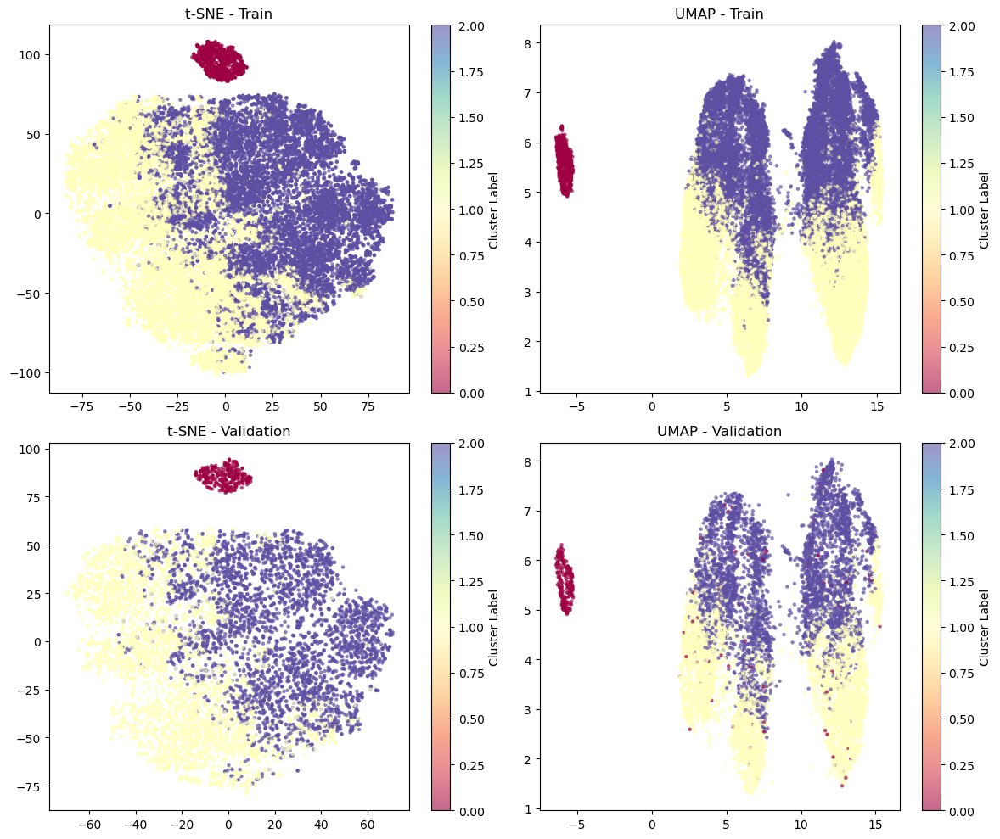

In [34]:
gaussian1 = GaussianMixture(n_components = 3, covariance_type='spherical', random_state=42).fit(X_pca_train)
labels_gaussian1 = gaussian1.predict(X_pca_train)
labels_dict['gaussian1'] = labels_gaussian1
labels_val_gaussian1 = gaussian1.predict(X_pca_val)
labels_dict_val['gaussian1'] = labels_val_gaussian1
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_gaussian1, labels_val_gaussian1)

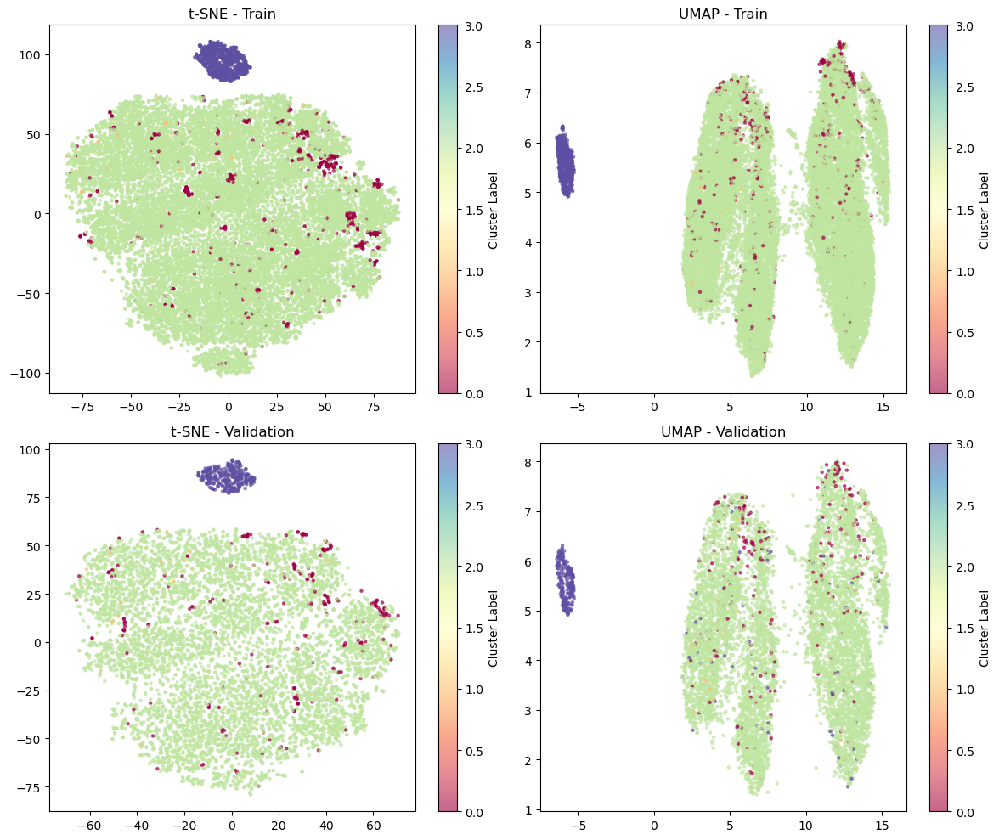

In [35]:
gaussian2 = GaussianMixture(n_components = 4, covariance_type='full', random_state=42).fit(X_pca_train)
labels_gaussian2 = gaussian2.predict(X_pca_train)
labels_dict['gaussian2'] = labels_gaussian2
labels_val_gaussian2 = gaussian2.predict(X_pca_val)
labels_dict_val['gaussian2'] = labels_val_gaussian2
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_gaussian2, labels_val_gaussian2)

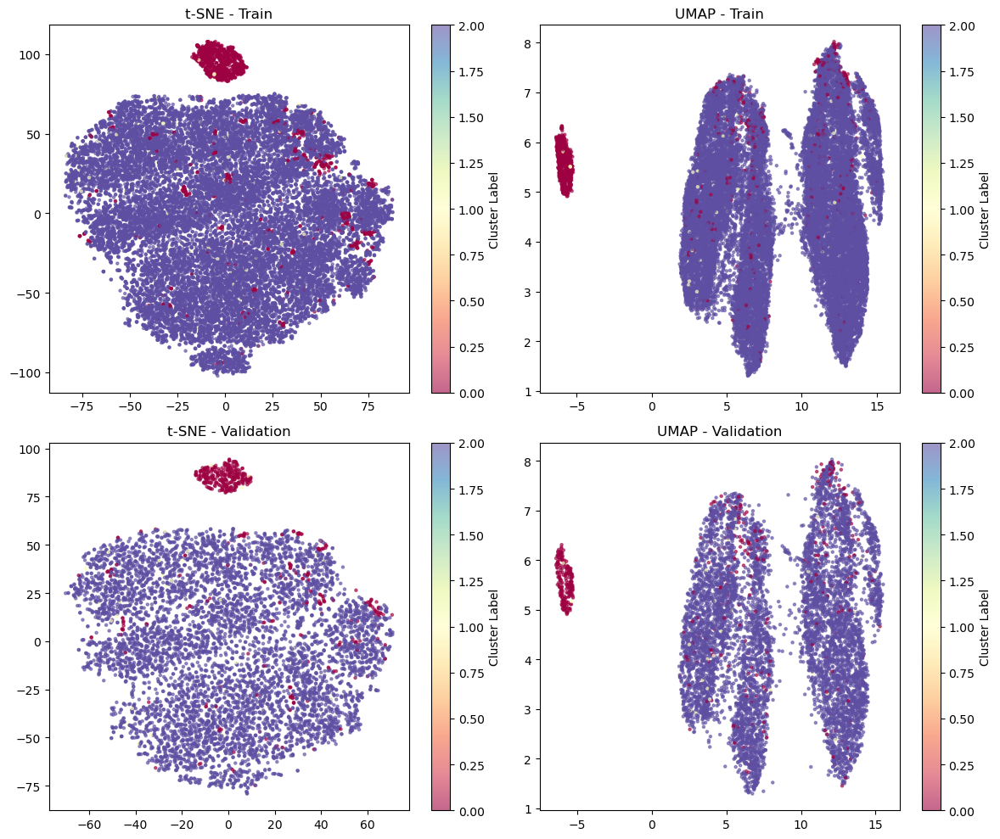

In [36]:
gaussian3 = GaussianMixture(n_components = 3, covariance_type='diag', random_state=42).fit(X_pca_train)
labels_gaussian3 = gaussian3.predict(X_pca_train)
labels_dict['gaussian3'] = labels_gaussian3
labels_val_gaussian3 = gaussian3.predict(X_pca_val)
labels_dict_val['gaussian3'] = labels_val_gaussian3
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_gaussian3, labels_val_gaussian3)

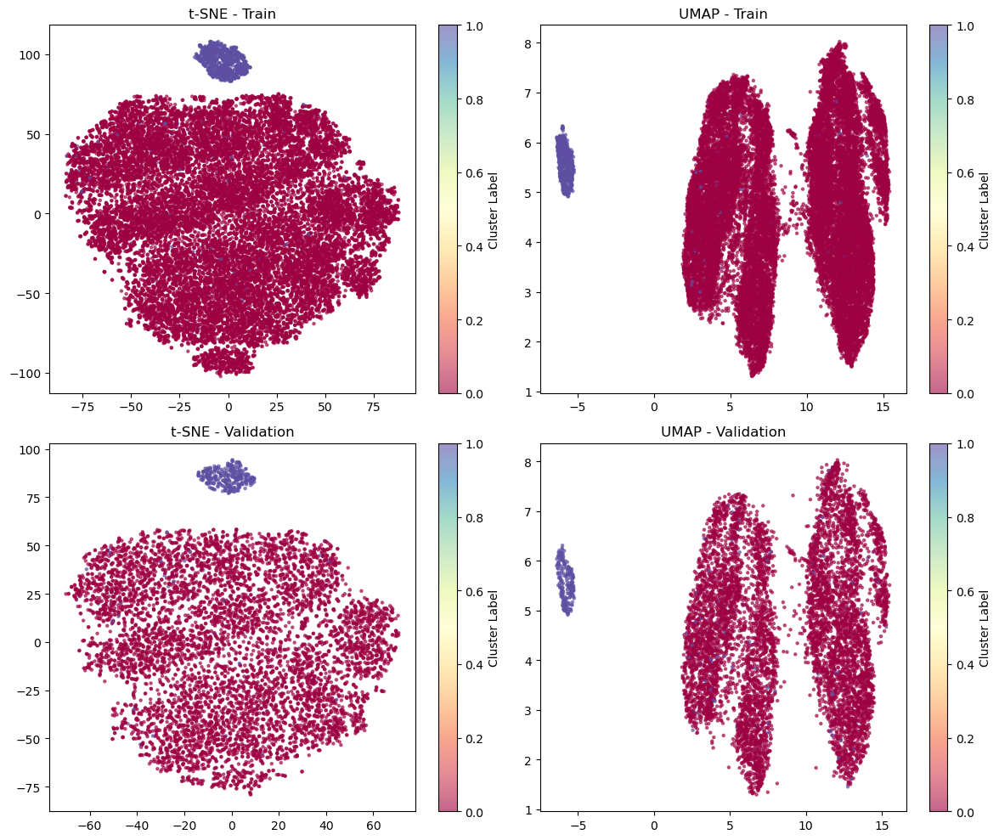

In [37]:
gaussian4 = GaussianMixture(n_components = 2, covariance_type='full', random_state=42).fit(X_pca_train)
labels_gaussian4 = gaussian4.predict(X_pca_train)
labels_dict['gaussian4'] = labels_gaussian4
labels_val_gaussian4 = gaussian4.predict(X_pca_val)
labels_dict_val['gaussian4'] = labels_val_gaussian4
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_gaussian4, labels_val_gaussian4)

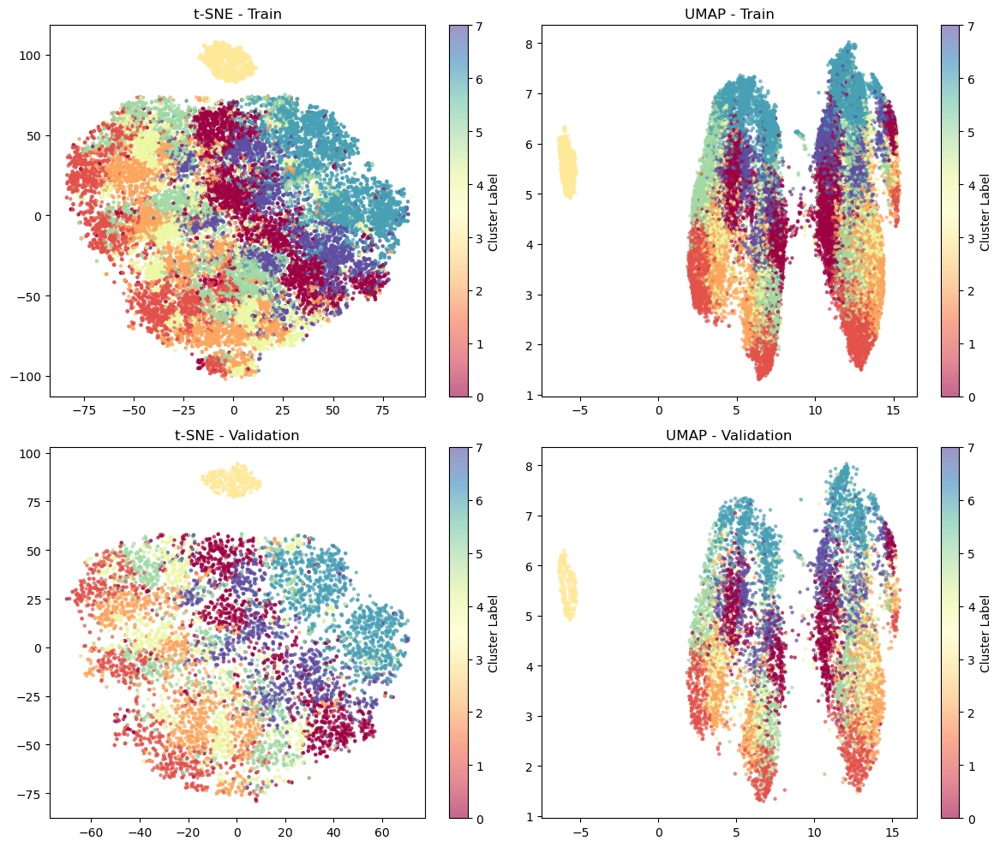

In [38]:
gaussian5 = GaussianMixture(n_components = 8, covariance_type='spherical', random_state=42).fit(X_pca_train)
labels_gaussian5 = gaussian5.predict(X_pca_train)
labels_dict['gaussian5'] = labels_gaussian5
labels_val_gaussian5 = gaussian5.predict(X_pca_val)
labels_dict_val['gaussian5'] = labels_val_gaussian5
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_gaussian5, labels_val_gaussian5)

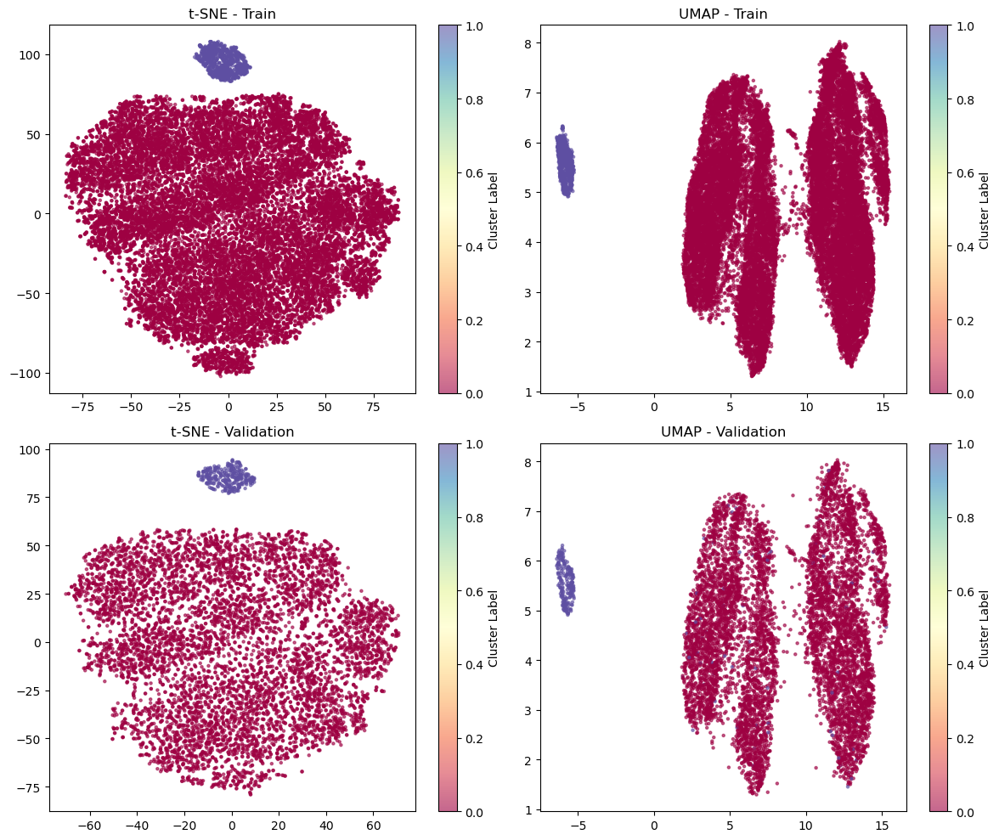

In [39]:
dbscan1 = DBSCAN(eps=5.0, min_samples=10) 
labels_dbscan1 = dbscan1.fit_predict(X_pca_train)
labels_dict['dbscan1'] = labels_dbscan1
knn_model.fit(X_pca_train, labels_dbscan1)
labels_val_dbscan1 = knn_model.predict(X_pca_val)
labels_dict_val['dbscan1'] = labels_val_dbscan1
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_dbscan1, labels_val_dbscan1)

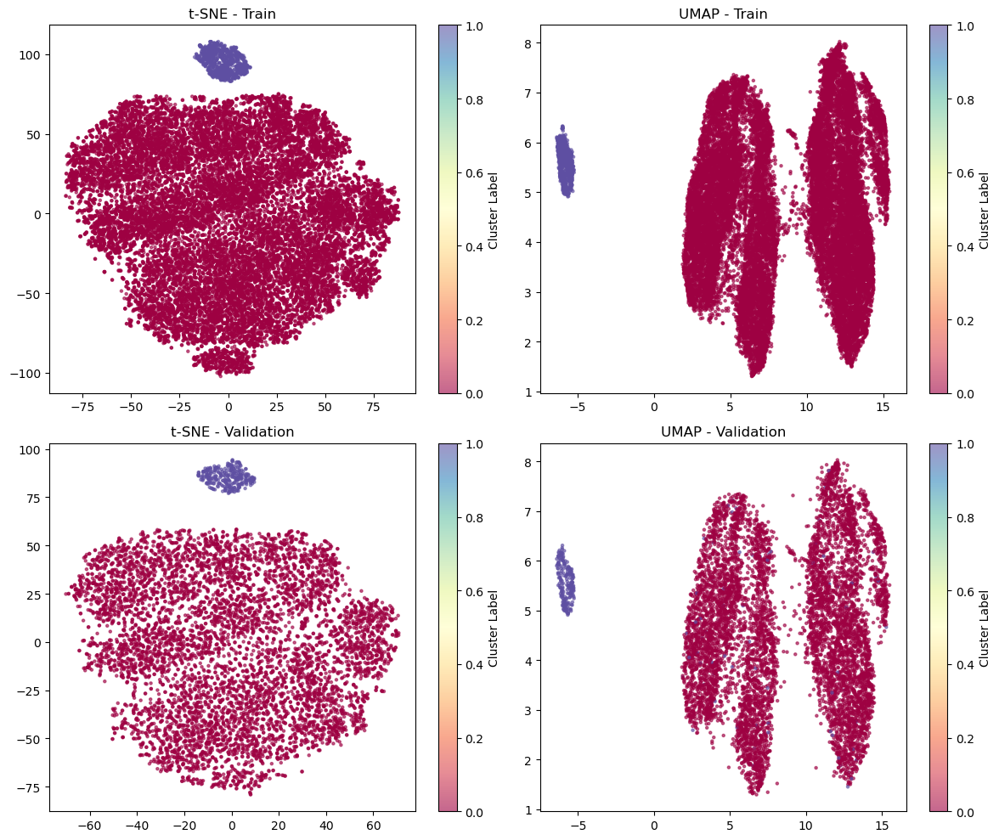

In [40]:
dbscan2 = DBSCAN(eps=5.0, min_samples=3) 
labels_dbscan2 = dbscan2.fit_predict(X_pca_train)
labels_dict['dbscan2'] = labels_dbscan2
knn_model.fit(X_pca_train, labels_dbscan2)
labels_val_dbscan2 = knn_model.predict(X_pca_val)
labels_dict_val['dbscan2'] = labels_val_dbscan2
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_dbscan2, labels_val_dbscan2)

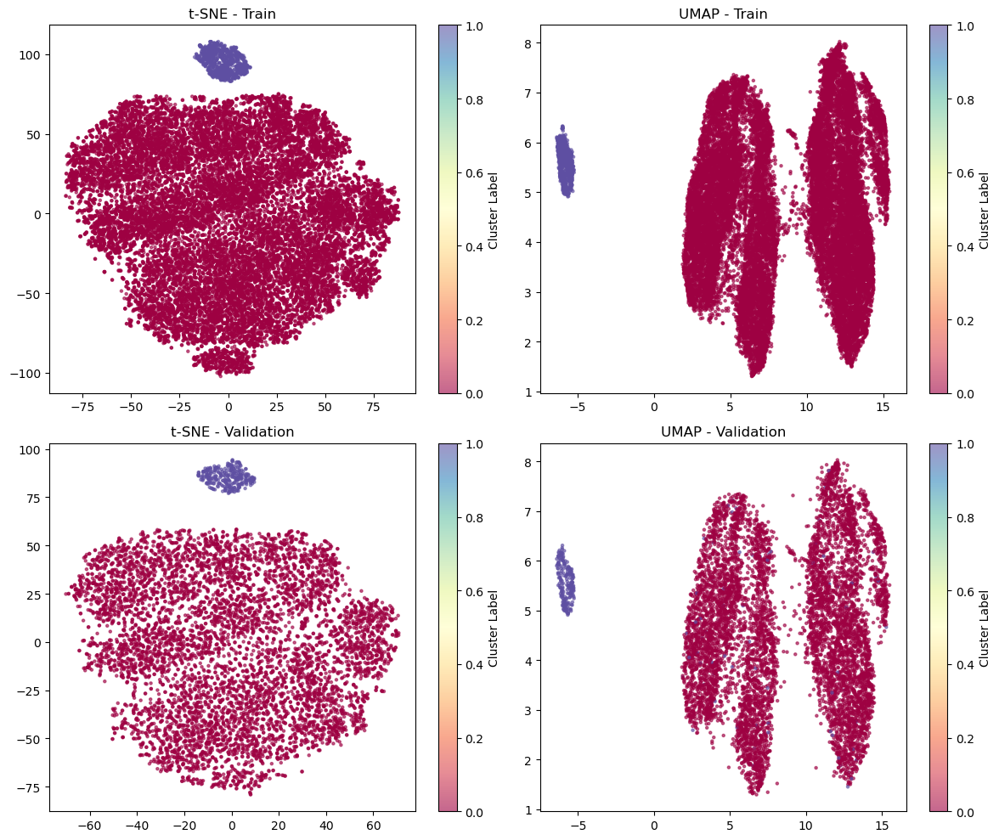

In [41]:
dbscan3 = DBSCAN(eps=5.0, min_samples=5) 
labels_dbscan3 = dbscan3.fit_predict(X_pca_train)
labels_dict['dbscan3'] = labels_dbscan3
knn_model.fit(X_pca_train, labels_dbscan3)
labels_val_dbscan3 = knn_model.predict(X_pca_val)
labels_dict_val['dbscan3'] = labels_val_dbscan3
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_dbscan3, labels_val_dbscan3)

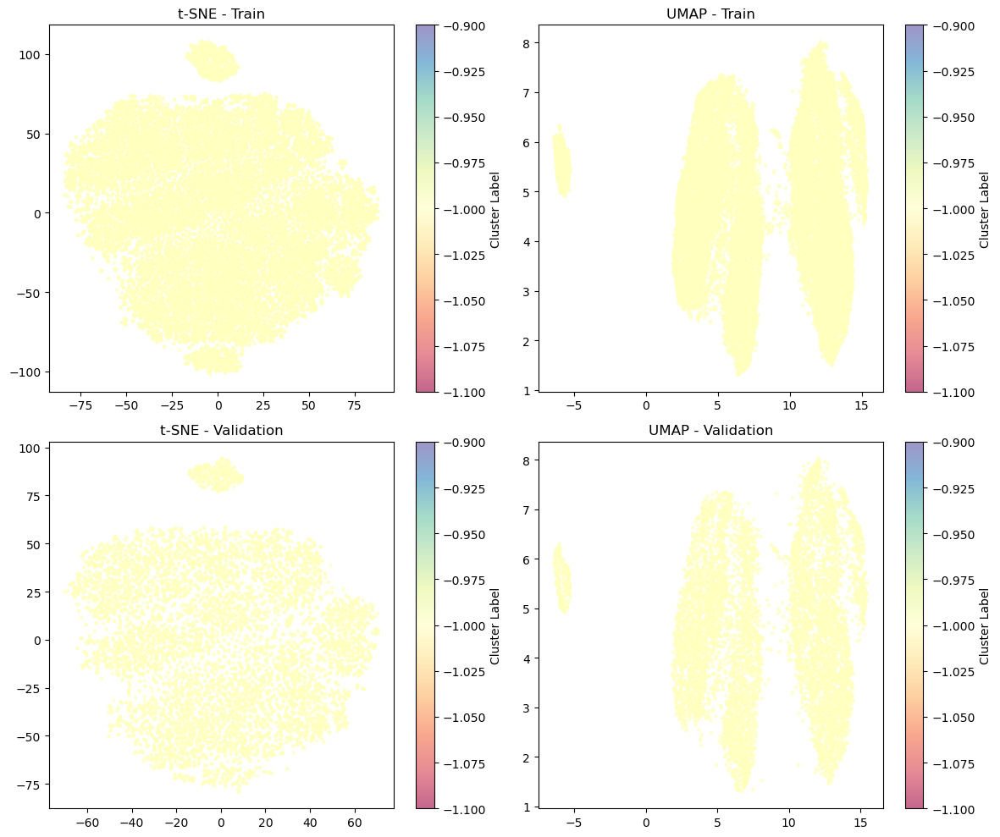

In [42]:
dbscan4 = DBSCAN(eps=0.3, min_samples=3) 
labels_dbscan4 = dbscan4.fit_predict(X_pca_train)
labels_dict['dbscan4'] = labels_dbscan4
knn_model.fit(X_pca_train, labels_dbscan4)
labels_val_dbscan4 = knn_model.predict(X_pca_val)
labels_dict_val['dbscan4'] = labels_val_dbscan4
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_dbscan4, labels_val_dbscan4)

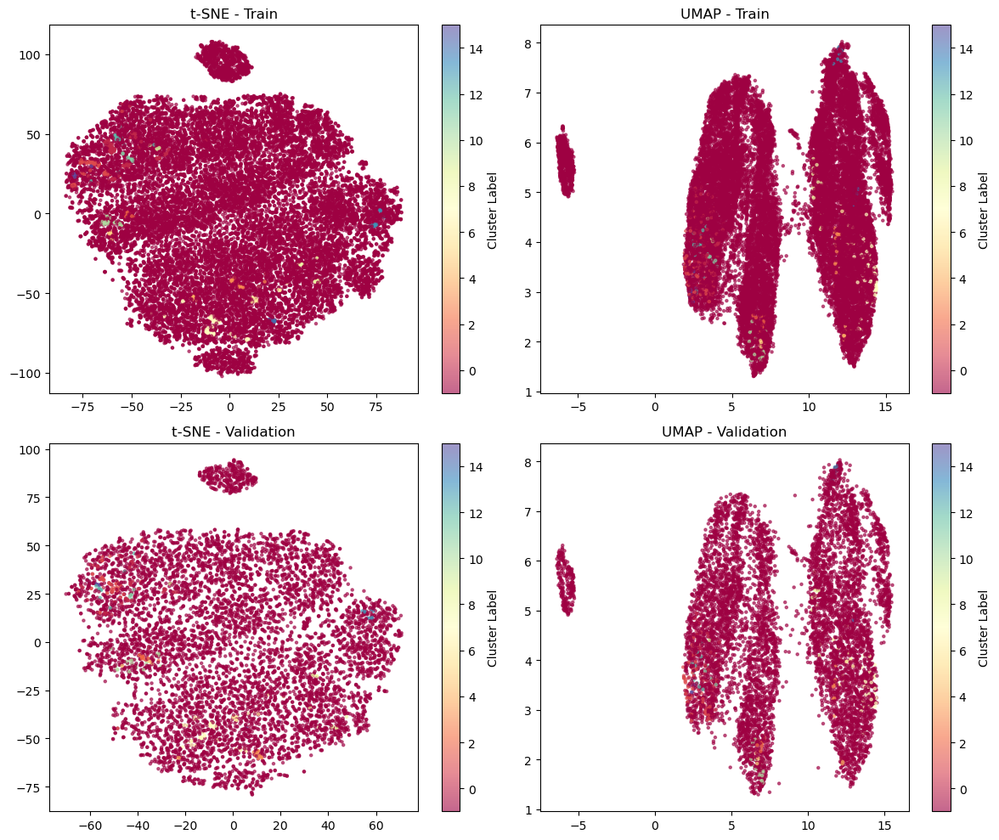

In [43]:
optics1 = OPTICS(max_eps=1, min_samples=10)
labels_optics1 = optics1.fit_predict(X_pca_train)
labels_dict['optics1'] = labels_optics1
knn_model.fit(X_pca_train, labels_optics1)
labels_val_optics1 = knn_model.predict(X_pca_val)
labels_dict_val['optics1'] = labels_val_optics1
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_optics1, labels_val_optics1)

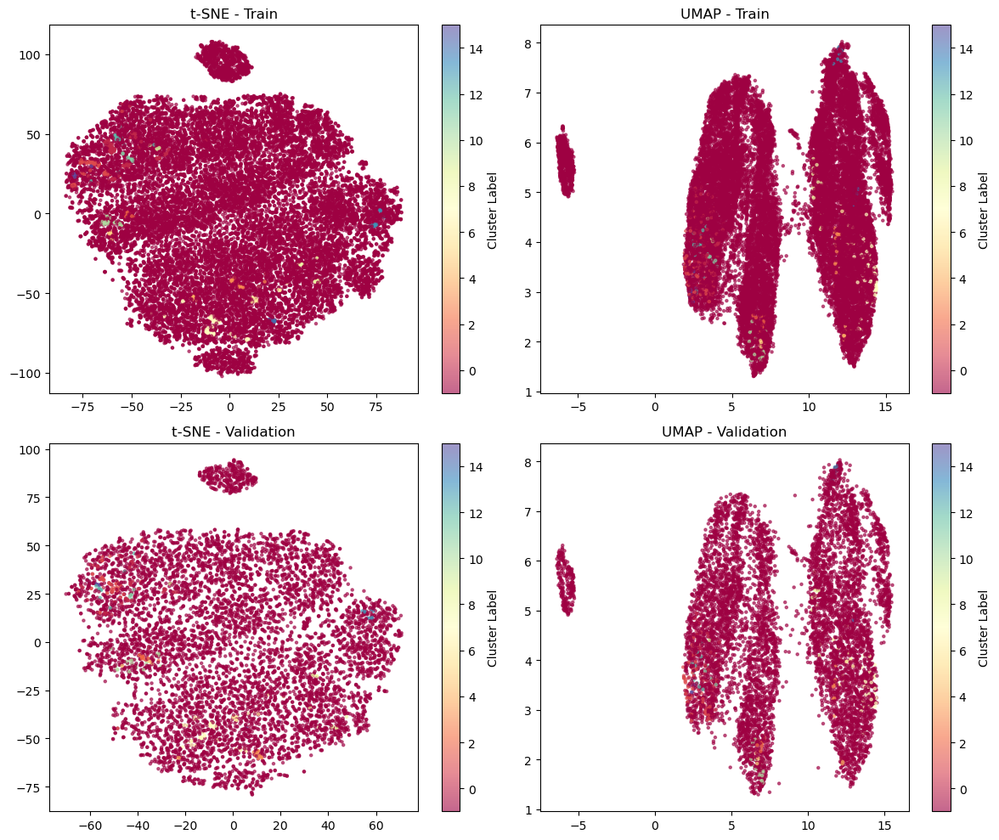

In [44]:
optics2 = OPTICS(max_eps=1.0, min_samples=10)
labels_optics2 = optics2.fit_predict(X_pca_train)
labels_dict['optics2'] = labels_optics2
knn_model.fit(X_pca_train, labels_optics2)
labels_val_optics2 = knn_model.predict(X_pca_val)
labels_dict_val['optics2'] = labels_val_optics2
plot_tsne_umap_clusters(X_tsne_train, X_umap_train, X_tsne_val, X_umap_val, labels_optics2, labels_val_optics2)

In [ ]:
# ciągła skala kolorów dla klastrów ???
# gaussian mixture graficznie wydaje się być akceptowalnym wyborem, trudności z poprawnym wykryciem więcej niż 2 klastrów

# Interpretowalność

In [45]:
def cpu_cluster_interpret(X, labels_dict, n_samples=5000, random_state=42):
    """
    CPU-based clustering interpretability analysis using SHAP
    
    Parameters:
        X (pd.DataFrame/np.ndarray): Input features
        labels_dict (dict): Dictionary of {model_name: cluster_labels}
        n_samples (int): Number of samples for SHAP analysis
        random_state (int): Reproducibility seed
    
    Returns:
        dict: SHAP values and feature importances for each clustering
    """
    # Convert to pandas DataFrame if not already
    if not isinstance(X, pd.DataFrame):
        X = pd.DataFrame(X)
    
    results = {}
    
    for name, labels in labels_dict.items():
        # Encode labels if needed
        le = LabelEncoder()
        encoded_labels = le.fit_transform(labels)
        
        # Subsample data
        if len(X) > n_samples:
            sample_idx = np.random.choice(len(X), n_samples, replace=False)
            X_sample = X.iloc[sample_idx]
            labels_sample = encoded_labels[sample_idx]
        else:
            X_sample = X
            labels_sample = encoded_labels
        
        # Train CPU RandomForest
        clf = RandomForestClassifier(n_estimators=100, 
                                   random_state=random_state,
                                   n_jobs=-1)  # Use all CPU cores
        clf.fit(X_sample, labels_sample)
        
        # Calculate SHAP values
        explainer = shap.TreeExplainer(clf)
        shap_values = explainer.shap_values(X_sample)
        
        # Calculate feature importance
        if isinstance(shap_values, list):
            feature_importance = np.mean([np.abs(v).mean(0) for v in shap_values], 0)
        else:
            feature_importance = np.abs(shap_values).mean(0)
        
        results[name] = {
            'shap_values': shap_values,
            'feature_importance': feature_importance,
            'features': X.columns.tolist()
        }
    
    return results


In [46]:
def plot_feature_importance(results):
    n_plots = len(results)
    n_cols = 3
    n_rows = (n_plots + n_cols - 1) // n_cols  # Zaokrąglenie w górę

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 5 * n_rows))
    axes = axes.flatten() if n_plots > 1 else [axes]

    for ax in axes[n_plots:]:
        ax.axis('off')  # Wyłącz niewykorzystane osie

    for i, (model_name, data) in enumerate(results.items()):
        features = data['features']
        importance = np.array(data['feature_importance']).flatten()
        
        # Dopasowanie długości
        min_len = min(len(features), len(importance))
        features = features[:min_len]
        importance = importance[:min_len]
        
        # Sortowanie według ważności malejąco
        sorted_idx = importance.argsort()[::-1]
        sorted_features = [features[j] for j in sorted_idx]
        sorted_importance = importance[sorted_idx]
        
        ax = axes[i]
        ax.barh(sorted_features, sorted_importance, color='skyblue')
        ax.set_xlabel('Mean Absolute SHAP Value')
        ax.set_title(f'Feature Importance for {model_name}')
        ax.invert_yaxis()  # Najważniejsze cechy na górze

    plt.tight_layout()
    plt.show()


In [47]:
results1 = cpu_cluster_interpret(X_train, labels_dict, n_samples=2000, random_state=42)

In [48]:
results2 = cpu_cluster_interpret(X_val, labels_dict_val, n_samples=2000, random_state=42)

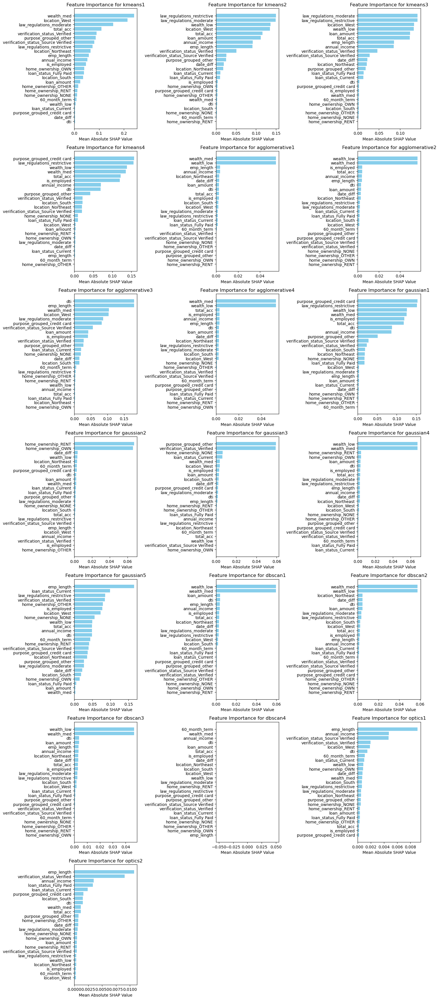

In [49]:
plot_feature_importance(results1)

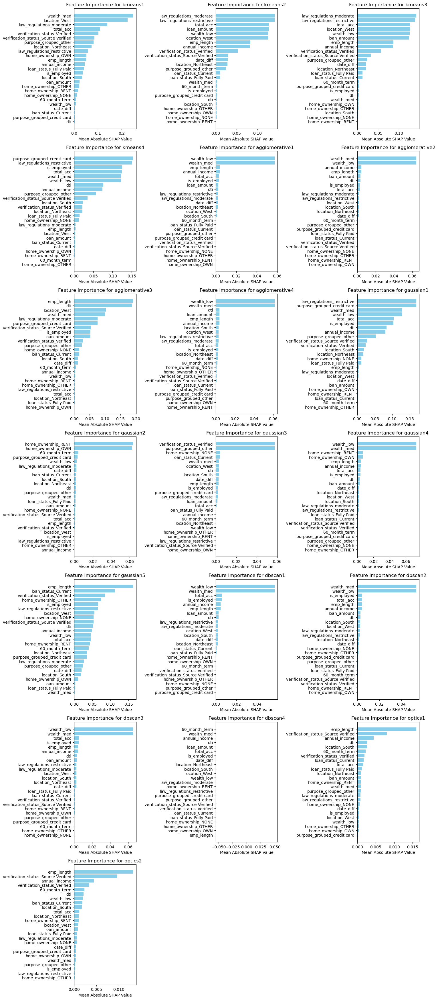

In [50]:
plot_feature_importance(results2)

In [ ]:
# zachowana istotność cech dla zbioru walidacyjnego ✅


# Analiza wrażliwości cech dla różnych klastrów

## GMM

In [51]:
data_train = X_train.copy()
data_val = X_val.copy()

In [52]:
data_train['cluster'] = labels_dict['gaussian1']
data_val['cluster'] = labels_dict_val['gaussian1']

In [53]:
def sensitivity_analysis(model, data, cluster_col='cluster', n_samples=2, epsilon=0.1):
    """
    Dla każdego klastra wybiera n_samples rekordów i wykonuje analizę wrażliwości cech
    (sensitivity analysis) dla każdego z nich, tworząc osobny wykres.
    
    Parametry:
    - model: wytrenowany model klasteryzujący (np. GaussianMixture, KMeans)
    - data: DataFrame zawierający dane i kolumnę z etykietami klastrów
    - cluster_col: nazwa kolumny z etykietami klastrów
    - n_samples: liczba rekordów do pobrania z każdego klastra (domyślnie 2)
    - epsilon: wielkość perturbacji cechy (domyślnie 0.1)
    """
    feature_names = [col for col in data.columns if col != cluster_col]
    selected_indices = []
    for cluster_id in data[cluster_col].unique():
        cluster_data = data[data[cluster_col] == cluster_id]
        if len(cluster_data) >= n_samples:
            sampled = cluster_data.sample(n=n_samples, random_state=42)
            selected_indices.extend(sampled.index.tolist())
        else:
            selected_indices.extend(cluster_data.index.tolist())
    
    for idx in selected_indices:
        record = data.loc[idx, feature_names].values
        probs = model.predict_proba(record.reshape(1, -1))[0]
        assigned_cluster = np.argmax(probs)
        sensitivity = []
        for i in range(len(record)):
            perturbed = record.copy()
            perturbed[i] += epsilon * np.std(model.means_[:, i])
            perturbed_probs = model.predict_proba(perturbed.reshape(1, -1))[0]
            delta = np.abs(perturbed_probs[assigned_cluster] - probs[assigned_cluster])
            sensitivity.append(delta)
        sensitivity = np.array(sensitivity)
        sensitivity_norm = sensitivity / sensitivity.sum() if sensitivity.sum() > 0 else sensitivity
        plt.figure(figsize=(10, 6))
        plt.bar(feature_names, sensitivity_norm, color='salmon')
        plt.title(f'Record {idx} (orig cluster: {data.loc[idx, cluster_col]}) - Assigned: {assigned_cluster}')
        plt.xlabel('Feature')
        plt.ylabel('Normalized Sensitivity')
        plt.xticks(rotation=45, ha='right')
        plt.tight_layout()
        plt.show()
        print(f"Record {idx}: Assigned cluster {assigned_cluster}, Original cluster: {data.loc[idx, cluster_col]}")
        print(f"Cluster probabilities: {probs}\n{'-'*60}")

In [54]:
import warnings
warnings.filterwarnings("ignore")

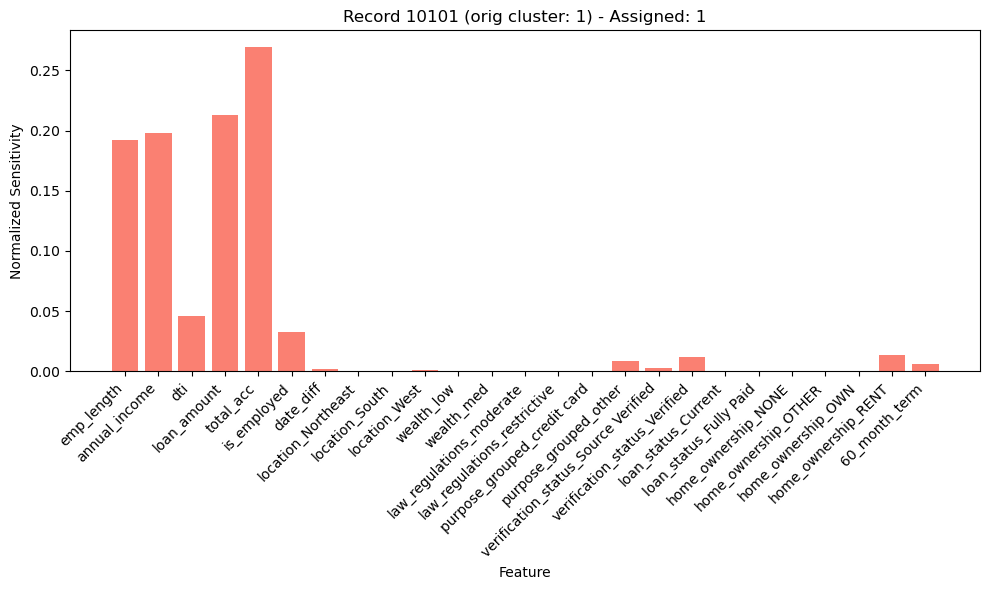

Record 10101: Assigned cluster 1, Original cluster: 1
Cluster probabilities: [2.72653081e-18 8.01168488e-01 1.98831512e-01]
------------------------------------------------------------


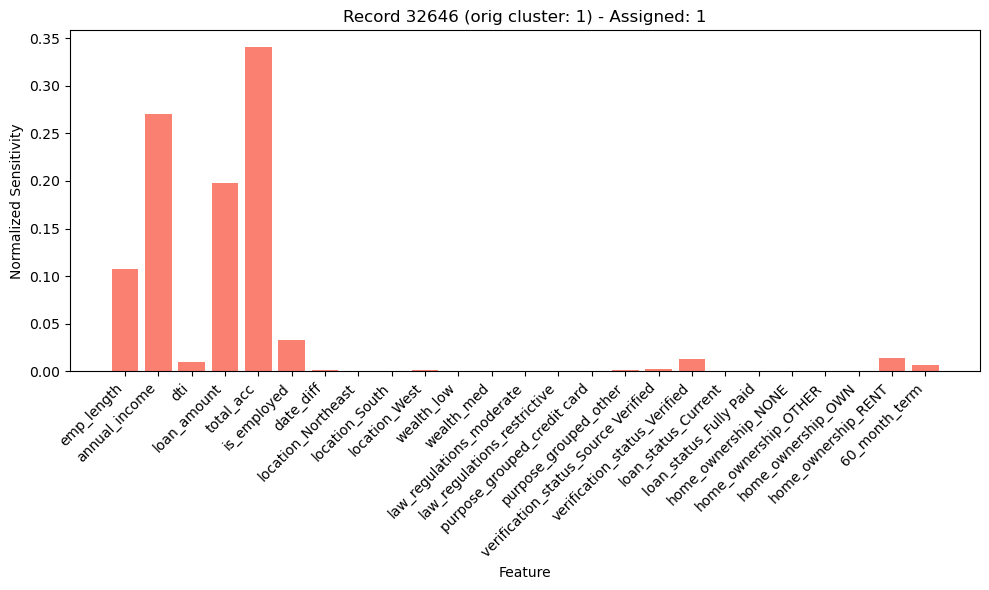

Record 32646: Assigned cluster 1, Original cluster: 1
Cluster probabilities: [3.07463924e-17 9.90403303e-01 9.59669663e-03]
------------------------------------------------------------


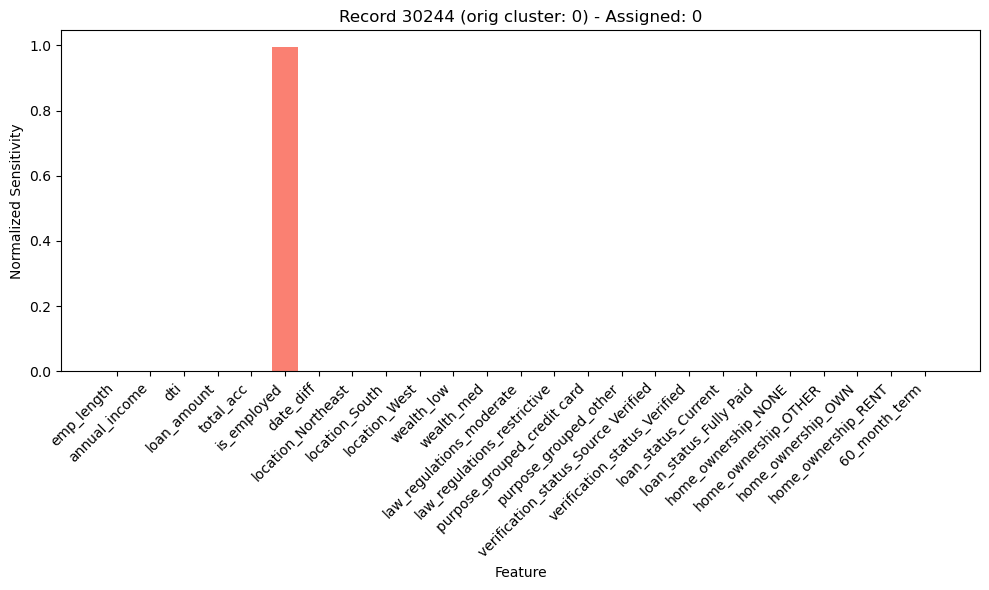

Record 30244: Assigned cluster 0, Original cluster: 0
Cluster probabilities: [1.00000000e+00 6.84941018e-34 7.19674388e-14]
------------------------------------------------------------


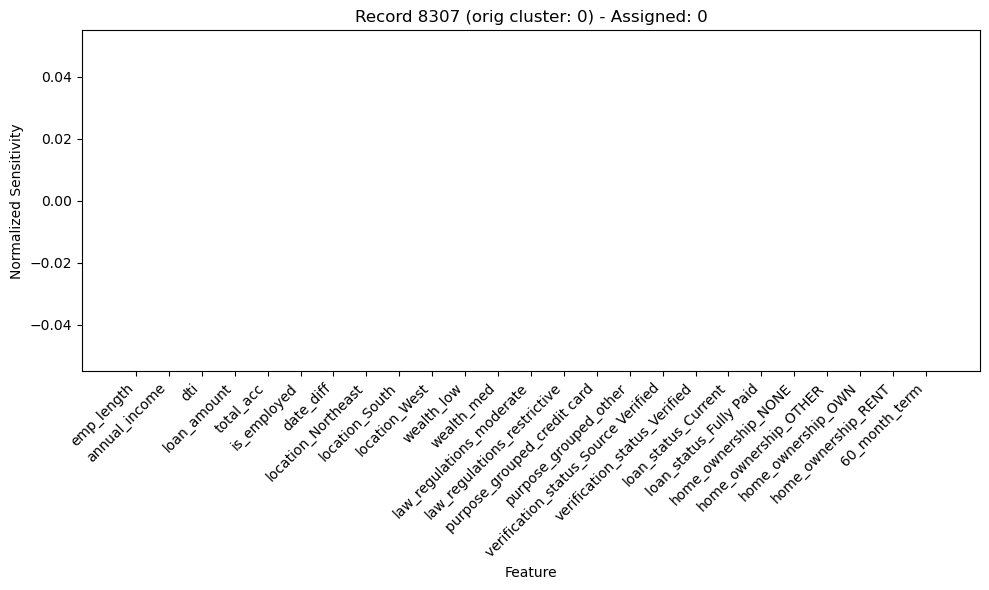

Record 8307: Assigned cluster 0, Original cluster: 0
Cluster probabilities: [1.00000000e+00 4.07345481e-22 1.57921490e-19]
------------------------------------------------------------


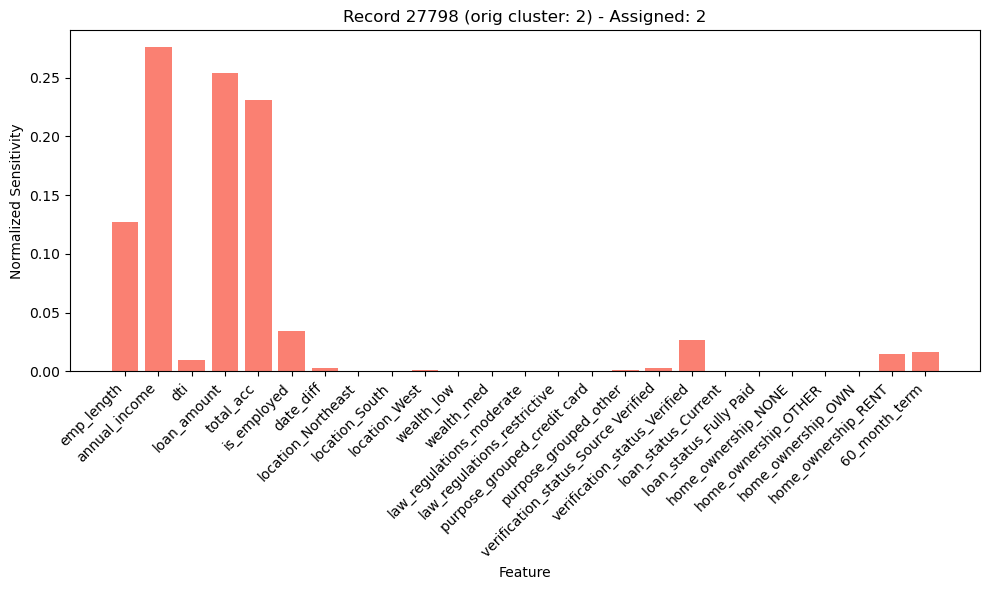

Record 27798: Assigned cluster 2, Original cluster: 2
Cluster probabilities: [3.96131243e-17 2.45362106e-01 7.54637894e-01]
------------------------------------------------------------


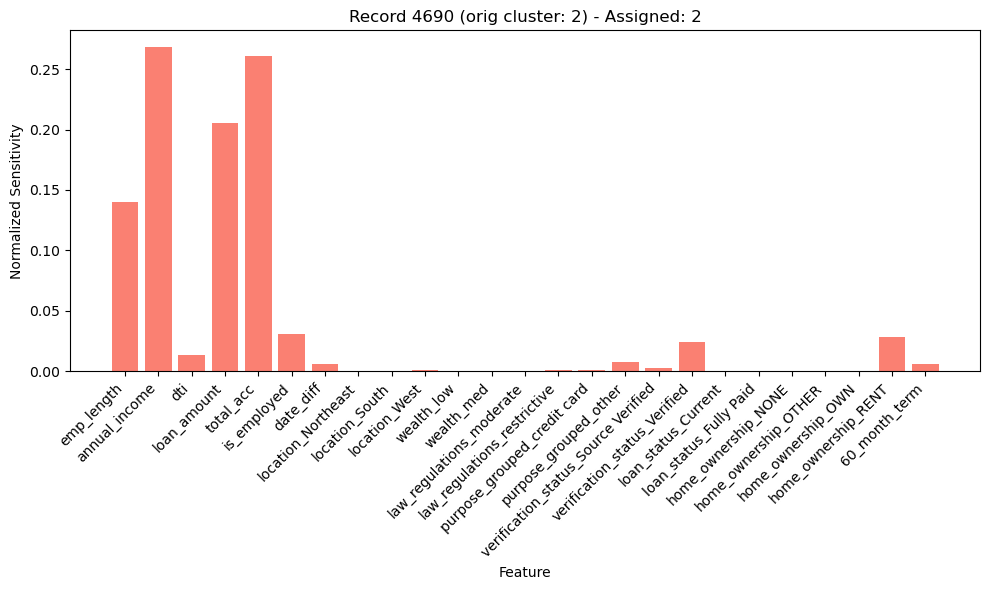

Record 4690: Assigned cluster 2, Original cluster: 2
Cluster probabilities: [1.41871545e-19 1.67037275e-06 9.99998330e-01]
------------------------------------------------------------


In [55]:
sensitivity_analysis(gaussian1, data_train, cluster_col='cluster', n_samples=2)

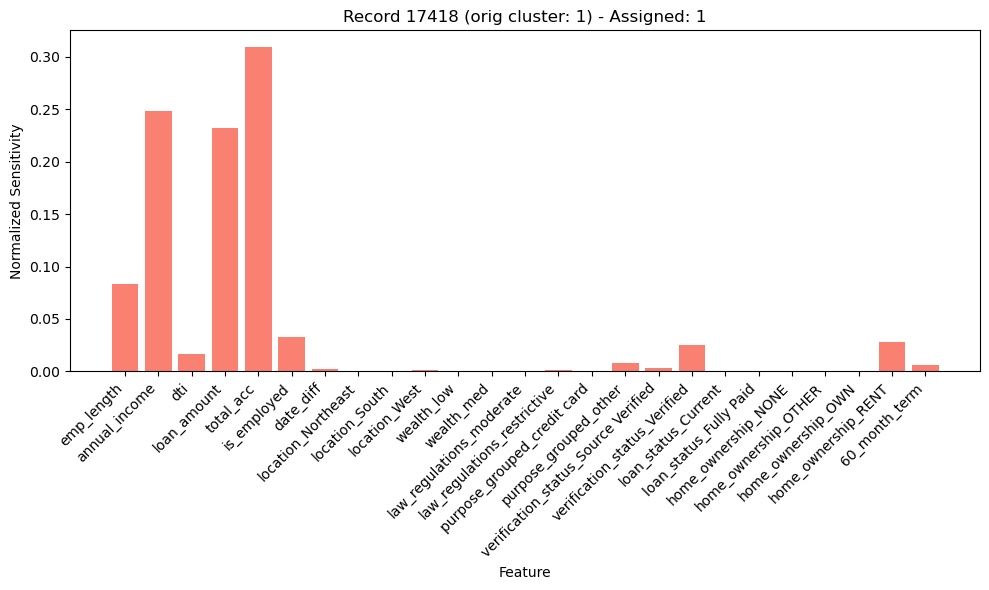

Record 17418: Assigned cluster 1, Original cluster: 1
Cluster probabilities: [7.24026208e-18 9.50042513e-01 4.99574869e-02]
------------------------------------------------------------


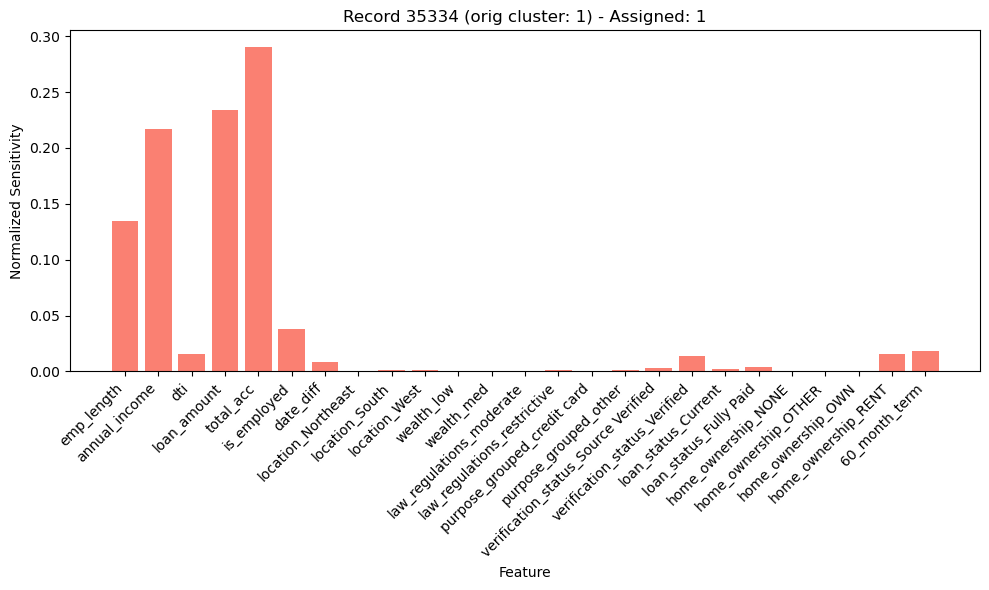

Record 35334: Assigned cluster 1, Original cluster: 1
Cluster probabilities: [2.02397937e-19 9.99987170e-01 1.28303660e-05]
------------------------------------------------------------


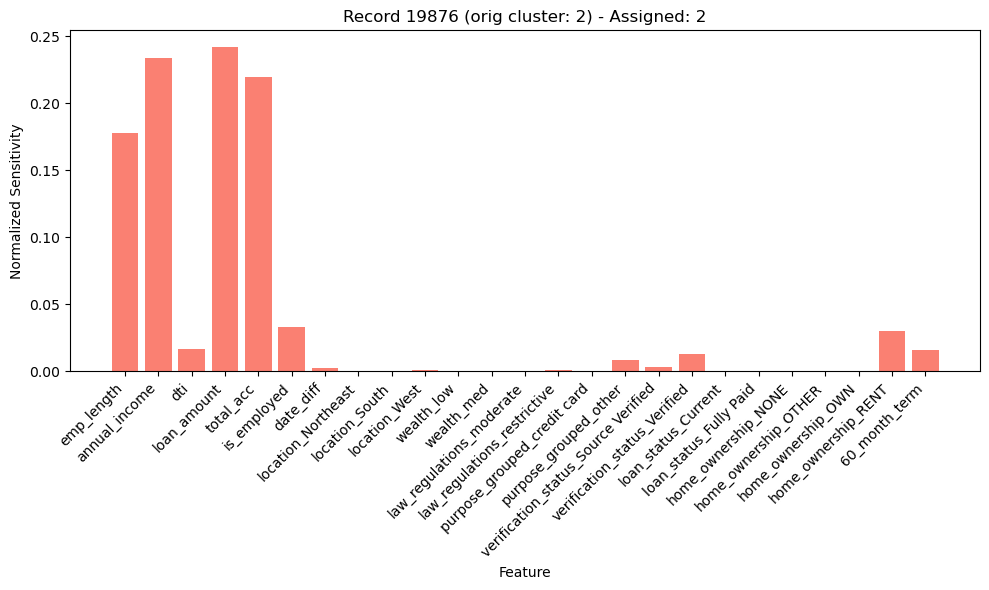

Record 19876: Assigned cluster 2, Original cluster: 2
Cluster probabilities: [1.98212518e-18 2.78448155e-03 9.97215518e-01]
------------------------------------------------------------


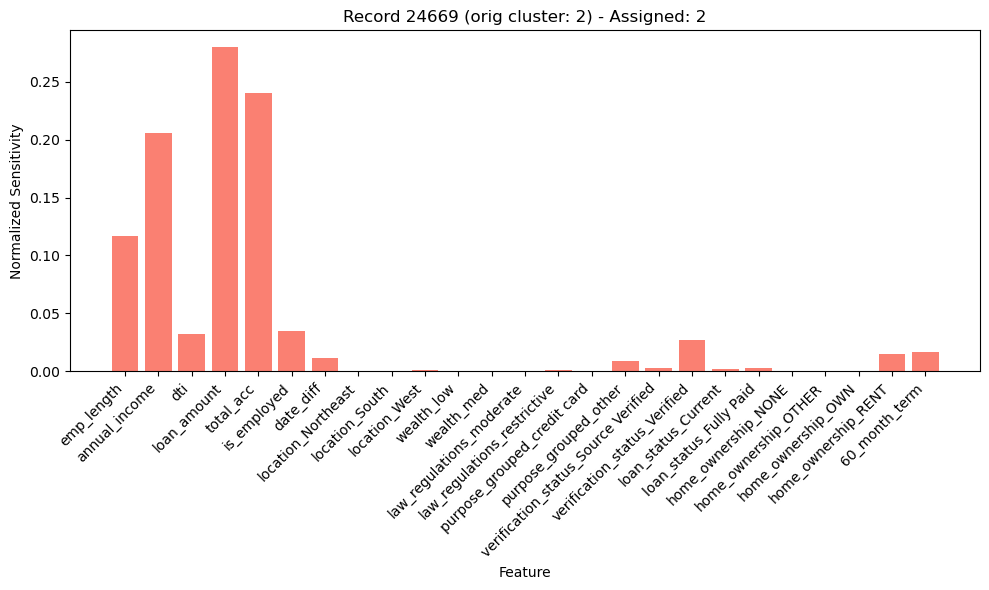

Record 24669: Assigned cluster 2, Original cluster: 2
Cluster probabilities: [1.82332987e-17 7.69858494e-02 9.23014151e-01]
------------------------------------------------------------


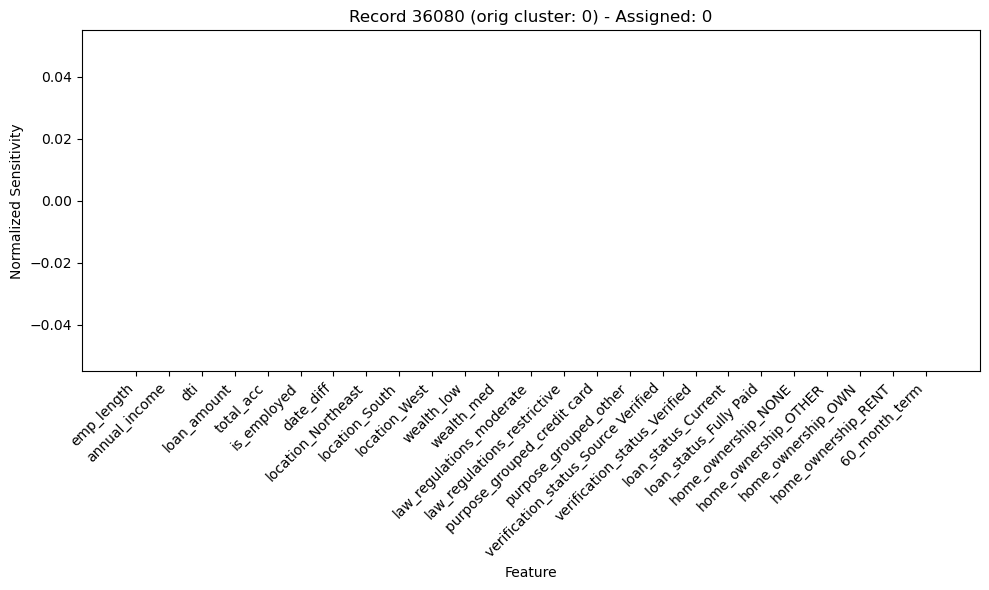

Record 36080: Assigned cluster 0, Original cluster: 0
Cluster probabilities: [1.00000000e+00 2.22041843e-20 3.08571773e-22]
------------------------------------------------------------


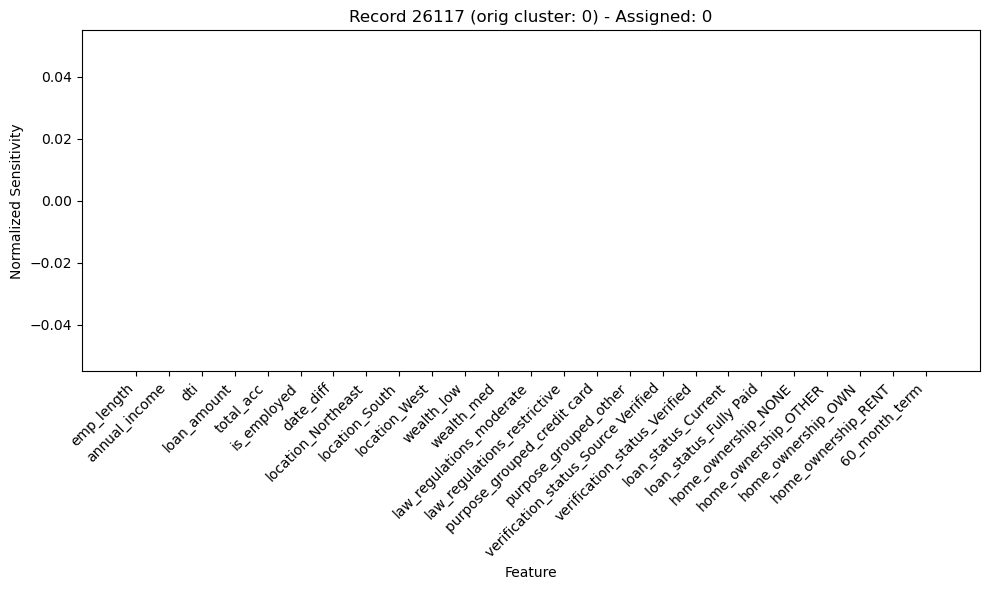

Record 26117: Assigned cluster 0, Original cluster: 0
Cluster probabilities: [1.00000000e+00 3.41663904e-23 2.67096857e-19]
------------------------------------------------------------


In [56]:
sensitivity_analysis(gaussian1, data_val, cluster_col='cluster', n_samples=2)

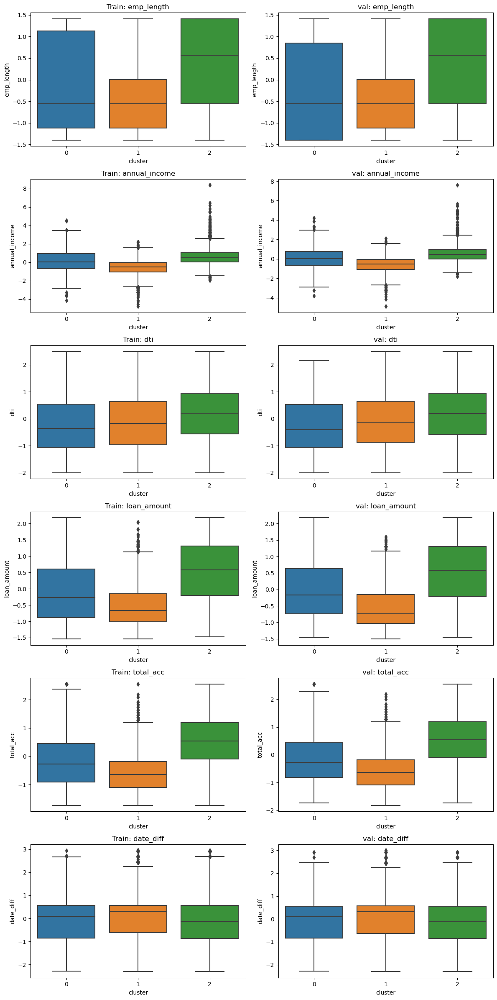

In [57]:
cols = ['emp_length', 'annual_income', 'dti', 'loan_amount', 'total_acc', 'date_diff']
n_cols = len(cols)
fig, axes = plt.subplots(n_cols, 2, figsize=(12, 4 * n_cols))

for i, col in enumerate(cols):
    sns.boxplot(x='cluster', y=col, data=data_train, ax=axes[i, 0])
    axes[i, 0].set_title(f'Train: {col}')
    
    sns.boxplot(x='cluster', y=col, data=data_val, ax=axes[i, 1])
    axes[i, 1].set_title(f'val: {col}')

plt.tight_layout()
plt.show()

In [ ]:
# Rozkład cech po klasteryzacji zachowany na zbiorze walidacyjnym ✅

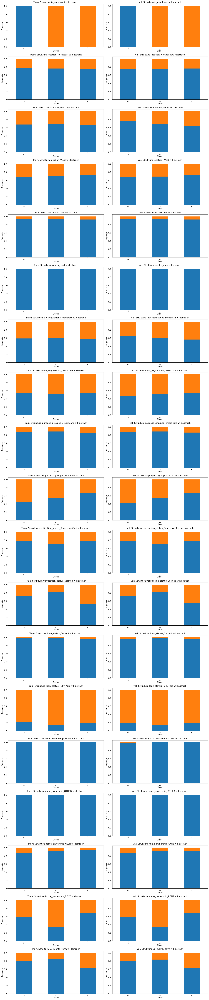

In [58]:
cols = ['is_employed', 'location_Northeast', 'location_South',
       'location_West', 'wealth_low', 'wealth_med', 'law_regulations_moderate',
       'law_regulations_restrictive', 'purpose_grouped_credit card',
       'purpose_grouped_other', 'verification_status_Source Verified',
       'verification_status_Verified', 'loan_status_Current',
       'loan_status_Fully Paid', 'home_ownership_NONE', 'home_ownership_OTHER',
       'home_ownership_OWN', 'home_ownership_RENT', '60_month_term']


fig, axes = plt.subplots(len(cols), 2, figsize=(16, 4 * len(cols)))

for i, col in enumerate(cols):
    pd.crosstab(data_train['cluster'], data_train[col], normalize='index').plot(
        kind='bar', stacked=True, ax=axes[i, 0], legend=False)
    axes[i, 0].set_title(f'Train: Struktura {col} w klastrach')
    axes[i, 0].set_ylabel('Proporcja')
    axes[i, 0].set_xlabel('Cluster')

    pd.crosstab(data_val['cluster'], data_val[col], normalize='index').plot(
        kind='bar', stacked=True, ax=axes[i, 1], legend=False)
    axes[i, 1].set_title(f'val: Struktura {col} w klastrach')
    axes[i, 1].set_ylabel('Proporcja')
    axes[i, 1].set_xlabel('Cluster')

plt.tight_layout()
plt.show()


In [61]:
#j.w. ✅

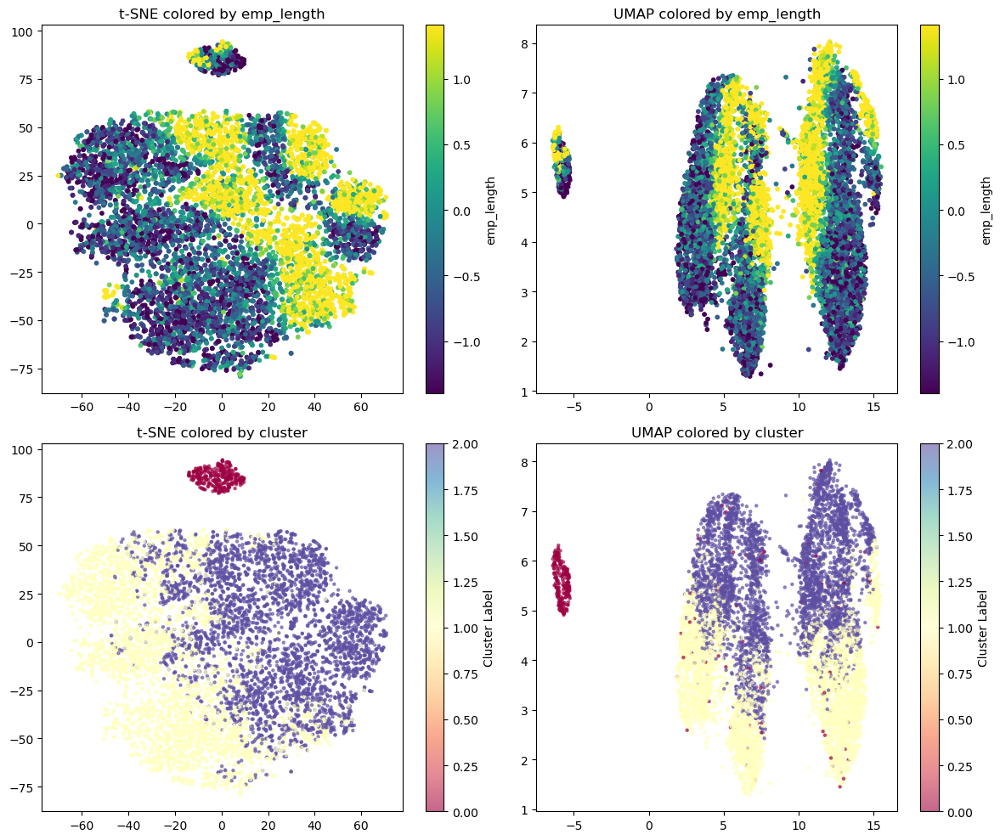

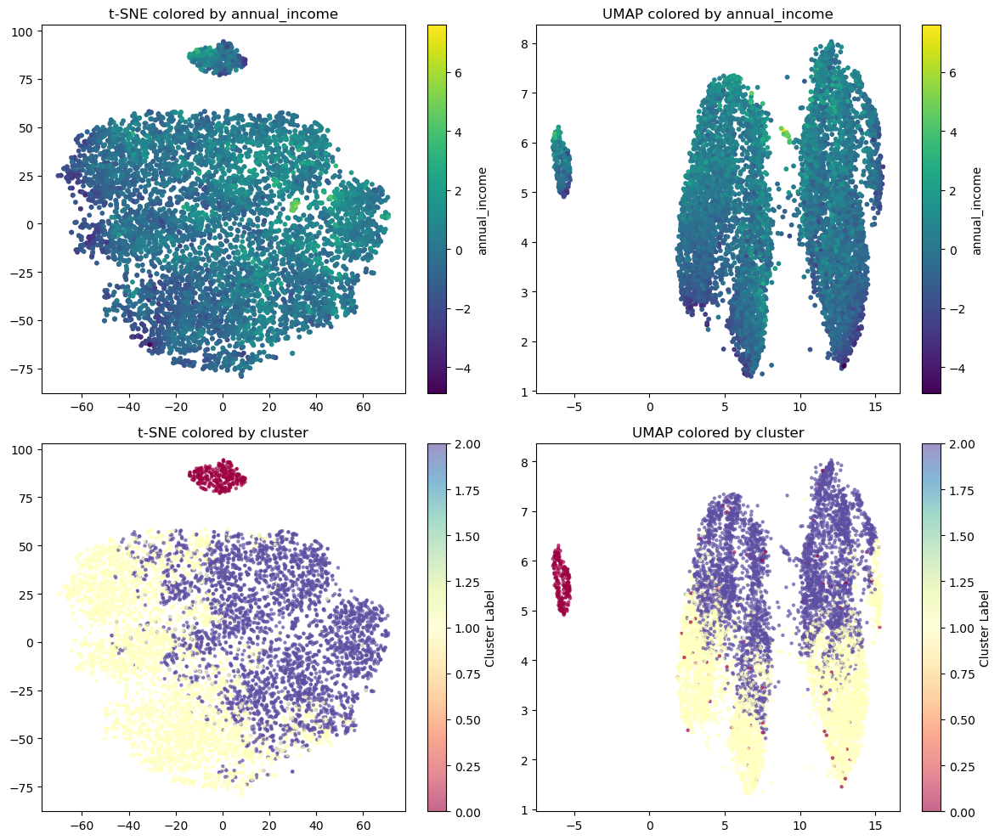

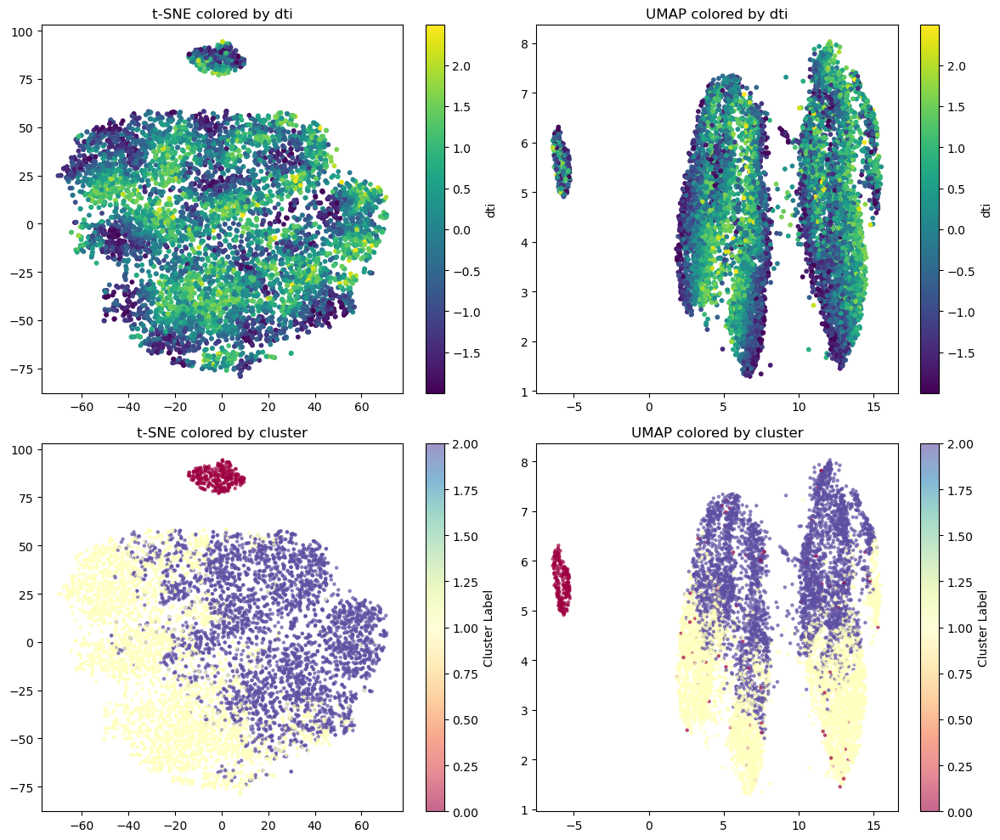

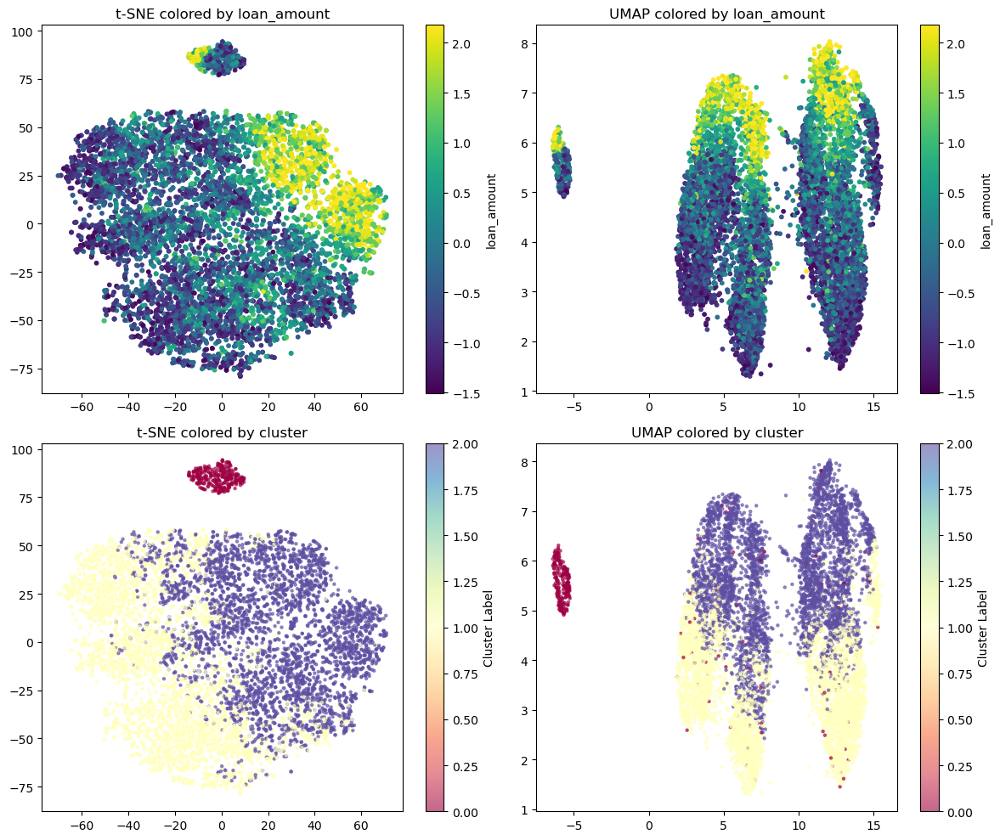

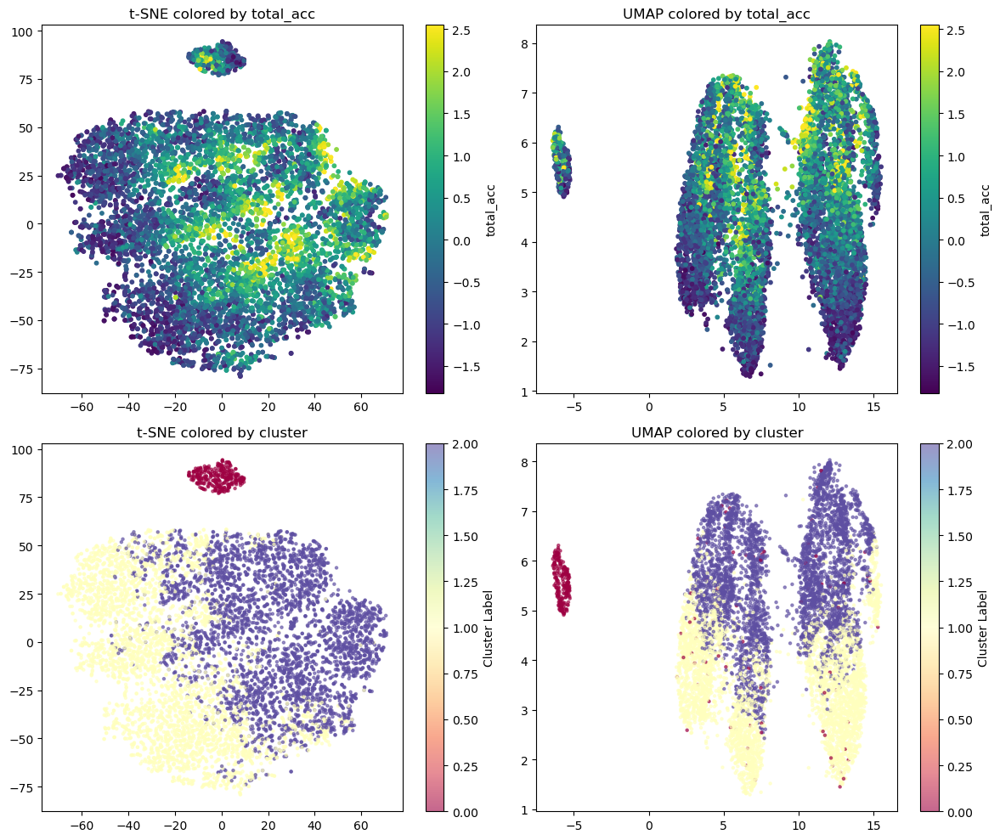

...

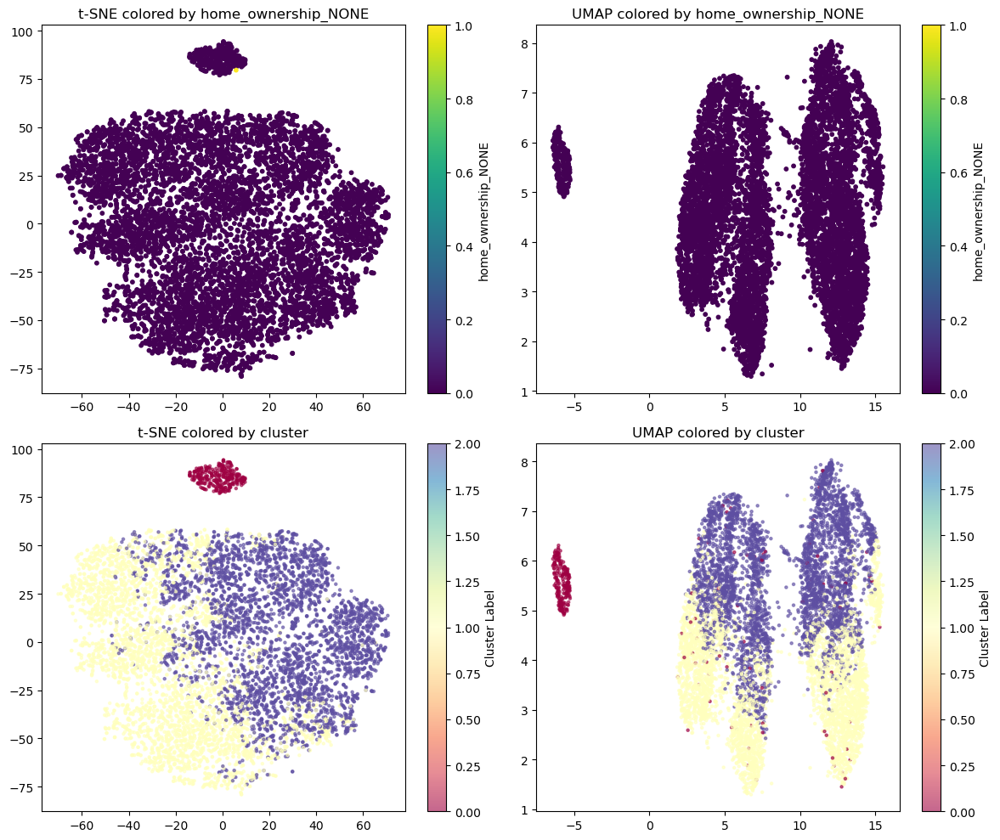

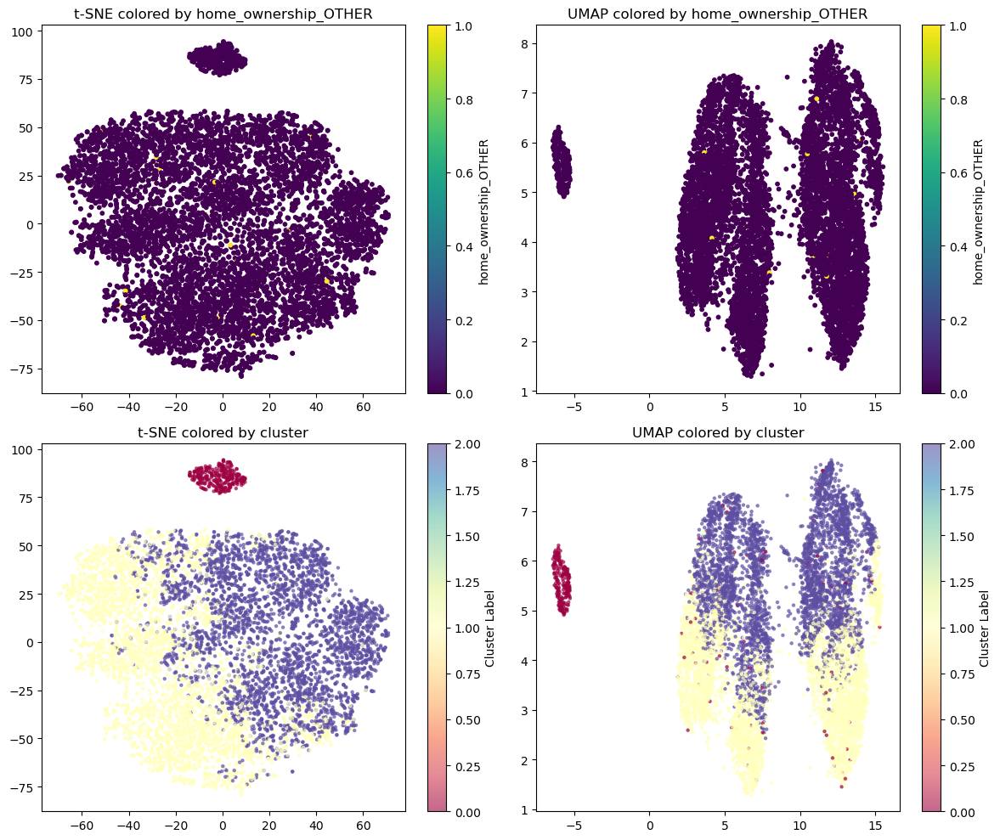

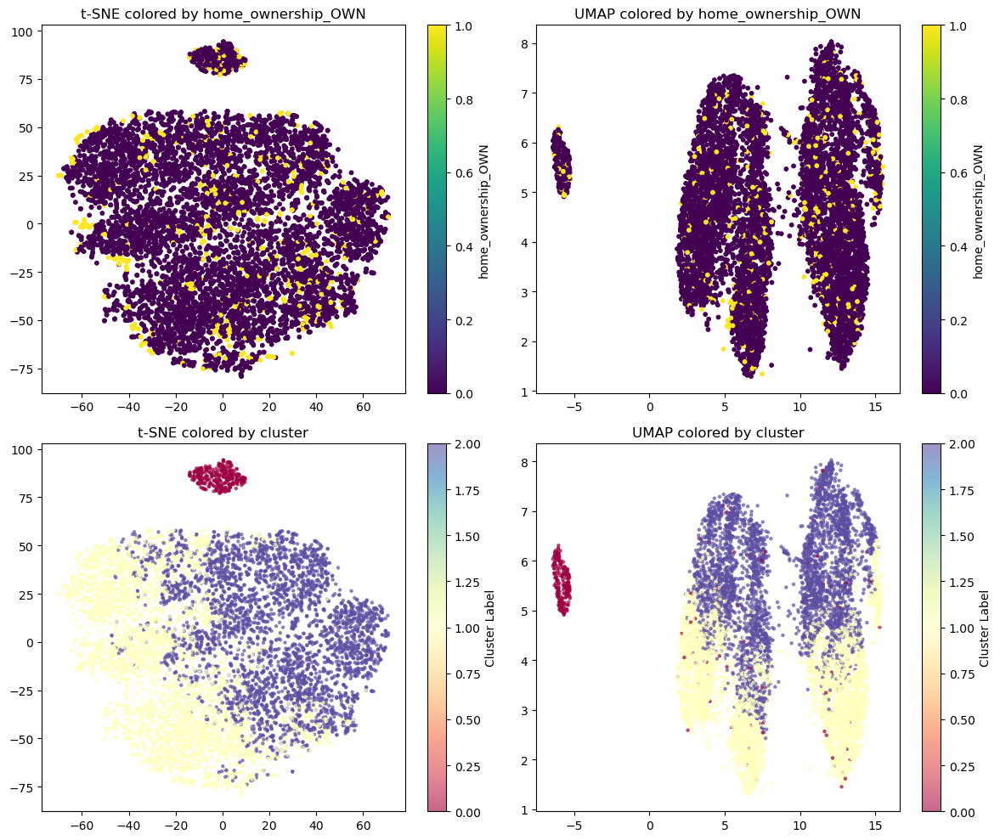

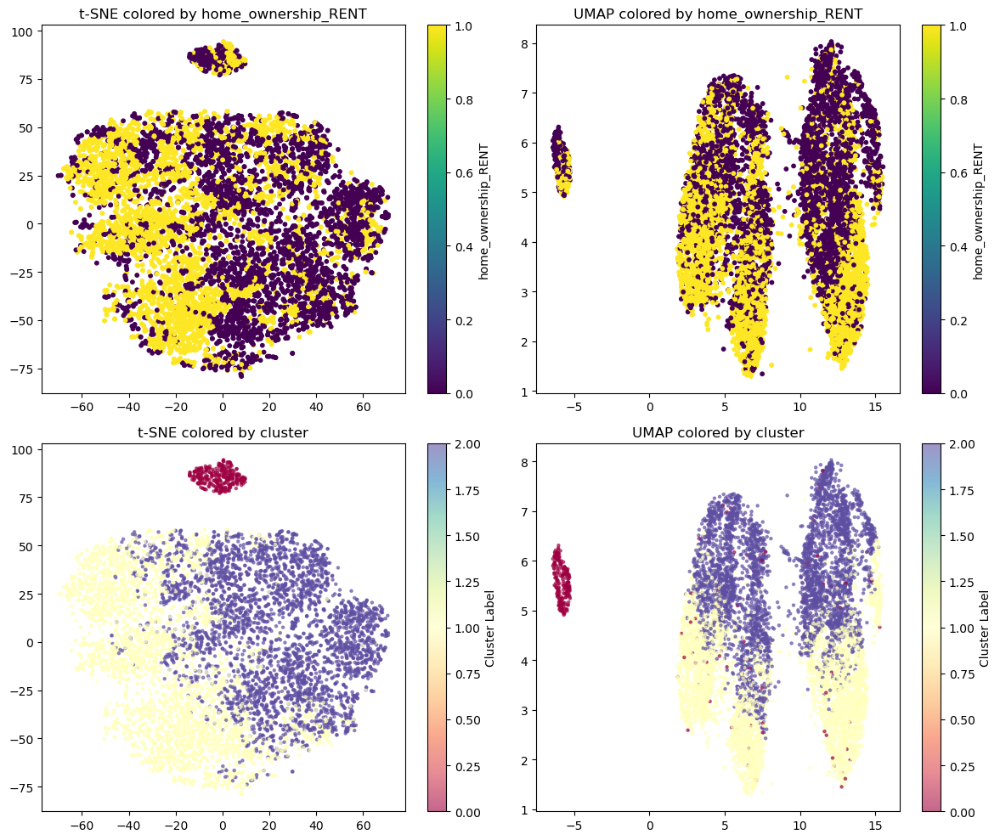

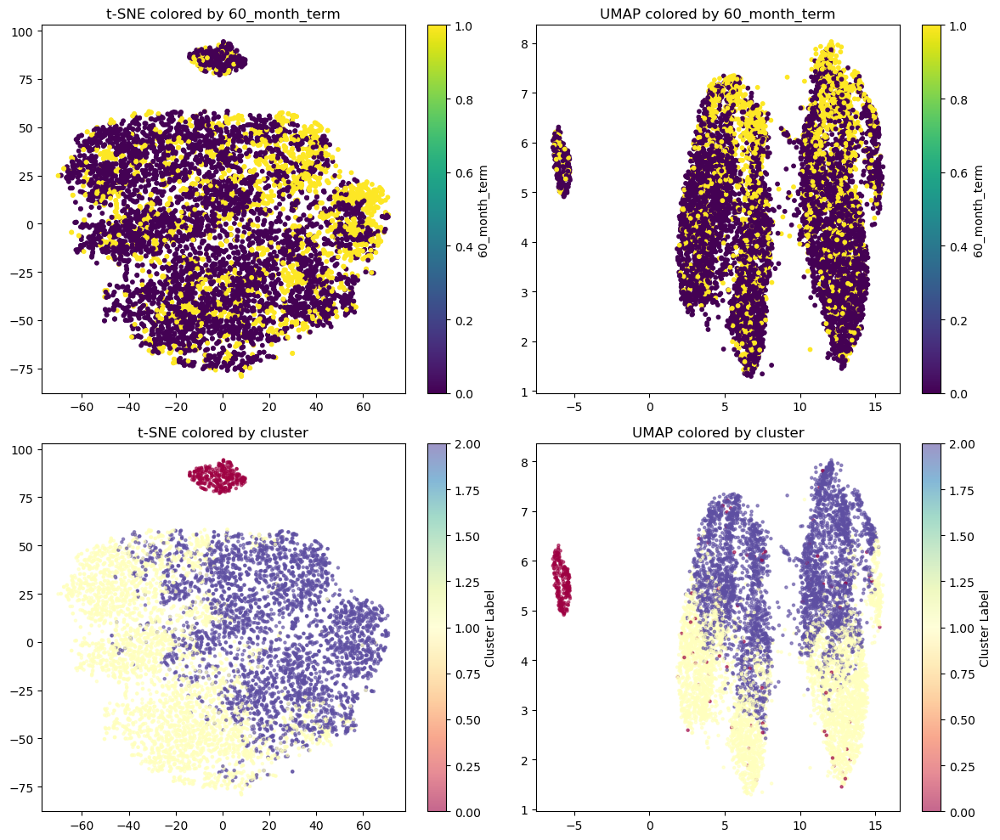

In [59]:
feature_names = X_val.columns

for feature in feature_names:
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    
    # t-SNE colored by feature
    sc = axes[0, 0].scatter(X_tsne_val[:, 0], X_tsne_val[:, 1], c=X_val[feature], cmap='viridis', s=10)
    axes[0, 0].set_title(f't-SNE colored by {feature}')
    plt.colorbar(sc, ax=axes[0, 0], label=feature)
    
    # UMAP colored by feature
    su = axes[0, 1].scatter(X_umap_val[:, 0], X_umap_val[:, 1], c=X_val[feature], cmap='viridis', s=10)
    axes[0, 1].set_title(f'UMAP colored by {feature}')
    plt.colorbar(su, ax=axes[0, 1], label=feature)
    
    # t-SNE colored by cluster
    sc1 = axes[1, 0].scatter(X_tsne_val[:, 0], X_tsne_val[:, 1], c=labels_val_gaussian1, s=5, alpha=0.6, cmap='Spectral')
    axes[1, 0].set_title('t-SNE colored by cluster')
    plt.colorbar(sc1, ax=axes[1, 0], label='Cluster Label')
    
    # UMAP colored by cluster
    sc2 = axes[1, 1].scatter(X_umap_val[:, 0], X_umap_val[:, 1], c=labels_val_gaussian1, s=5, alpha=0.6, cmap='Spectral')
    axes[1, 1].set_title('UMAP colored by cluster')
    plt.colorbar(sc2, ax=axes[1, 1], label='Cluster Label')
    
    plt.tight_layout()
    plt.show()